In [3]:
import scanpy as sc, anndata as ad
import math
import os


# todo: work on imports
import sys
sys.path.append("../")
#from mir.common import parser, Repertoire, SegmentLibrary
#from mir.distances import ClonotypeAligner, AlignGermline
#from mir.comparative import DenseMatch

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import numpy as np
from collections import Counter
import time
import umap as um
import pandas as pd
import seaborn as sns

from sklearn.cluster import KMeans,DBSCAN
from sklearn.feature_selection import f_classif
from scipy import stats

import matplotlib as mpl
from matplotlib.text import TextPath
from matplotlib.patches import PathPatch
from matplotlib.font_manager import FontProperties

from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_curve, auc


import scipy.sparse as sp_sparse
#import tables


In [4]:
import scvi
import bbknn
import scib

In [5]:
import warnings
warnings.filterwarnings('ignore')

In [6]:
import muon as mu

from muon import atac as ac
from muon import prot as pt

In [7]:
sc.settings.figdir = "/home/ykremlyakova/projects/tcr_emb/results/figures/"

## Donor 1

In [119]:
donor = 'donor1'

In [120]:
#data_path = '/home/ykremlyakova/projects/tcr_emb/data/10x/healthy/donor1/filtered_feature_bc_matrix'
data_path = f'/home/ykremlyakova/projects/tcr_emb/data/10x/healthy/donor1/vdj_v1_hs_aggregated_{donor}_filtered_feature_bc_matrix.h5'

In [121]:
mdata = mu.read_10x_h5(data_path)
mdata.shape

(55206, 33602)

In [122]:
mu.pp.intersect_obs(mdata)
mdata.shape

(55206, 33602)

In [134]:
prot_1 = mdata['prot']
prot_1.obs['sample'] = donor

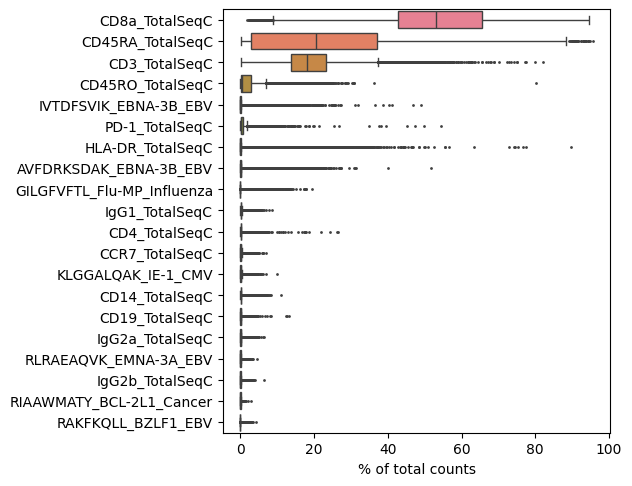

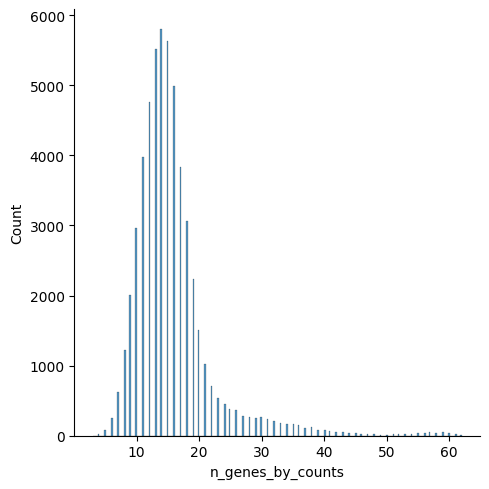

In [9]:
sc.pl.highest_expr_genes(mdata['prot'], n_top=20)
sc.pp.calculate_qc_metrics(mdata["prot"], inplace=True, percent_top=None)
sc.pp.calculate_qc_metrics(mdata["rna"], inplace=True, percent_top=None)
sns.displot(mdata["prot"].obs.n_genes_by_counts)

In [10]:
klg = mdata['prot'].var_names.str.startswith('KLG')
prot = mdata['prot'][:,np.invert(klg)]
mu.prot.pp.clr(prot)
sc.tl.pca(prot)

sc.pp.neighbors(prot)
sc.tl.umap(prot, random_state=1)

sc.tl.leiden(prot, key_added="leiden_res0_5", resolution=0.5)
sc.tl.leiden(prot, key_added="leiden_res0_75", resolution=0.75)
sc.tl.leiden(prot, key_added="leiden_res1", resolution=1.0)
sc.tl.leiden(prot, key_added="leiden_res2", resolution=2.0)
sc.tl.leiden(prot, key_added="leiden_res3", resolution=3.0)
sc.tl.leiden(prot, key_added="leiden_res4", resolution=4.0)
sc.tl.tsne(prot, use_rep="X_pca")

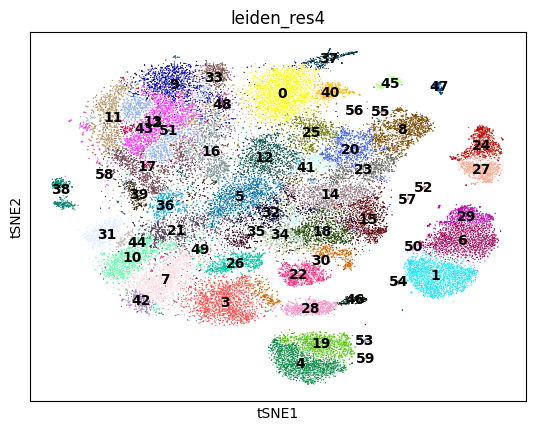

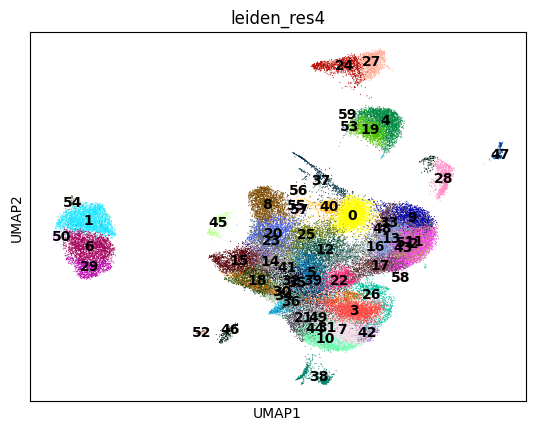

In [75]:
l = 'leiden_res4'
sc.pl.tsne(
    prot,
    color=[l],
    legend_loc="on data",
)
sc.pl.umap(
    prot,
    color=[l],
    legend_loc="on data",
)

In [65]:
l = 'leiden_res4'
sc.tl.rank_genes_groups(prot, l, method="t-test")
result = prot.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.set_option('display.max_columns', 50)
t = pd.DataFrame(
    {group: result['names'][group]
    for group in groups}).head(1).T.rename({0:'top_tetramer'},axis=1)
t = t.reset_index().rename({'index':l},axis=1)

t2 = pd.DataFrame(
    {group: result['pvals'][group]
    for group in groups}).head(1).T.rename({0:'pvals'},axis=1)
t2 = t2.reset_index().rename({'index':l},axis=1)
prot.obs.rename({'n_genes_by_counts':'cluster_size'},axis=1).groupby(l).count()['cluster_size'].reset_index().merge(t).merge(t2)

,leiden_res4,cluster_size,top_tetramer,pvals
0,0,2613,CCR7_TotalSeqC,0.000000e+00
1,1,2384,IVTDFSVIK_EBNA-3B_EBV,0.000000e+00
2,2,2282,CCR7_TotalSeqC,0.000000e+00
3,3,2229,CD14_TotalSeqC,0.000000e+00
4,4,2030,GILGFVFTL_Flu-MP_Influenza,0.000000e+00
5,5,1882,RLRAEAQVK_EMNA-3A_EBV,0.000000e+00
6,6,1837,IVTDFSVIK_EBNA-3B_EBV,0.000000e+00
7,7,1754,CD45RA_TotalSeqC,0.000000e+00
8,8,1678,HLA-DR_TotalSeqC,0.000000e+00
9,9,1661,CCR7_TotalSeqC,0.000000e+00


In [34]:
sc.tl.rank_genes_groups(prot, "leiden_res2", method="t-test")
result = prot.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.set_option('display.max_columns', 50)
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals']}).head(10)

,0_n,0_p,1_n,1_p,2_n,2_p,3_n,3_p,4_n,4_p,5_n,5_p,6_n,6_p,7_n,7_p,8_n,8_p,9_n,9_p,10_n,10_p,11_n,11_p,12_n,...,23_p,24_n,24_p,25_n,25_p,26_n,26_p,27_n,27_p,28_n,28_p,29_n,29_p,30_n,30_p,31_n,31_p,32_n,32_p,33_n,33_p,34_n,34_p,35_n,35_p
0,CCR7_TotalSeqC,0.000000e+00,GILGFVFTL_Flu-MP_Influenza,0.000000e+00,CCR7_TotalSeqC,0.000000e+00,CCR7_TotalSeqC,0.000000e+00,RLRAEAQVK_EMNA-3A_EBV,0.000000e+00,CD45RA_TotalSeqC,0.000000e+00,CCR7_TotalSeqC,0.000000e+00,IVTDFSVIK_EBNA-3B_EBV,0.000000e+00,CD45RO_TotalSeqC,9.881313e-324,CD45RO_TotalSeqC,0.000000e+00,IVTDFSVIK_EBNA-3B_EBV,0.000000e+00,CD14_TotalSeqC,0.000000e+00,CD45RA_TotalSeqC,...,0.000000e+00,CD45RO_TotalSeqC,9.872756e-277,ELAGIGILTV_MART-1_Cancer,9.703839e-258,RLRAEAQVK_EMNA-3A_EBV,4.950827e-169,IgG2a_TotalSeqC,3.854096e-195,PD-1_TotalSeqC,3.908350e-61,RAKFKQLL_BZLF1_EBV,4.412543e-207,LLDFVRFMGV_EBNA-3B_EBV,6.280183e-120,QPRAPIRPI_EBNA-6_EBV,7.590087e-36,GLCTLVAML_BMLF1_EBV,2.212533e-26,FLYALALLL_LMP2A_EBV,3.903476e-15,LLFGYPVYV_HTLV-1,3.488644e-14,MLDLQPETT_16E7_HPV,3.111102e-08
1,CD45RA_TotalSeqC,0.000000e+00,CD45RO_TotalSeqC,5.667002e-40,CD45RA_TotalSeqC,0.000000e+00,CD45RA_TotalSeqC,0.000000e+00,AVFDRKSDAK_EBNA-3B_EBV,0.000000e+00,CD3_TotalSeqC,8.181243e-27,CD45RA_TotalSeqC,0.000000e+00,CD45RO_TotalSeqC,0.000000e+00,CD127_TotalSeqC,8.365238e-01,RLRAEAQVK_EMNA-3A_EBV,0.000000e+00,CD45RO_TotalSeqC,0.000000e+00,IgG2a_TotalSeqC,2.256699e-304,IgG2b_TotalSeqC,...,6.614497e-306,IgG1_TotalSeqC,3.365893e-214,CD45RA_TotalSeqC,1.095977e-94,CCR7_TotalSeqC,8.259922e-147,IgG2b_TotalSeqC,5.071622e-193,CD45RA_TotalSeqC,2.531516e-17,CD8a_TotalSeqC,4.543647e-72,CD45RO_TotalSeqC,5.086293e-62,LLDFVRFMGV_EBNA-3B_EBV,1.191945e-32,CD45RO_TotalSeqC,1.008288e-03,CD45RO_TotalSeqC,4.132942e-12,CD45RA_TotalSeqC,3.285025e-02,CD45RA_TotalSeqC,2.843901e-05
2,CD8a_TotalSeqC,0.000000e+00,YLLEMLWRL_LMP1_EBV,2.151750e-03,PD-1_TotalSeqC,0.000000e+00,IgG2b_TotalSeqC,0.000000e+00,RIAAWMATY_BCL-2L1_Cancer,2.033418e-69,CD127_TotalSeqC,4.302482e-06,CD127_TotalSeqC,5.716125e-01,HLA-DR_TotalSeqC,0.000000e+00,SLYNTVATLY_Gag-protein_HIV,1.302329e-06,AVFDRKSDAK_EBNA-3B_EBV,6.311235e-261,IgG1_TotalSeqC,0.000000e+00,CD45RA_TotalSeqC,7.036257e-241,CD3_TotalSeqC,...,2.572381e-258,PD-1_TotalSeqC,1.458936e-126,CCR7_TotalSeqC,1.476158e-15,AVFDRKSDAK_EBNA-3B_EBV,1.636186e-139,CCR7_TotalSeqC,3.209508e-187,CD3_TotalSeqC,1.778647e-05,CD3_TotalSeqC,1.514301e-58,IgG1_TotalSeqC,4.706527e-28,FLRGRAYGL_EBNA-3A_EBV,2.778943e-32,CD8a_TotalSeqC,8.018731e-03,IgG1_TotalSeqC,5.359346e-03,AYAQKIFKI_IE-1_CMV,1.512086e-01,CCR7_TotalSeqC,1.258972e-01
3,CD3_TotalSeqC,0.000000e+00,IMDQVPFSV_gp100_Cancer,1.065587e-01,IgG2a_TotalSeqC,0.000000e+00,CD3_TotalSeqC,7.884111e-52,VTEHDTLLY_IE-1_CMV,1.036648e-11,LLMGTLGIVC_HPV-16E7_82-91,7.597131e-09,RAKFKQLL_BZLF1_EBV,1.652825e-11,PD-1_TotalSeqC,0.000000e+00,CLGGLLTMV_LMP-2A_EBV,1.083767e-13,PD-1_TotalSeqC,1.364408e-159,PD-1_TotalSeqC,0.000000e+00,CD4_TotalSeqC,8.822224e-173,CD8a_TotalSeqC,...,3.951419e-46,CD3_TotalSeqC,2.863454e-100,SLYNTVATLY_Gag-protein_HIV,5.752969e-01,CD45RA_TotalSeqC,6.215141e-17,HLA-DR_TotalSeqC,8.315192e-187,CD8a_TotalSeqC,9.663984e-04,PD-1_TotalSeqC,1.483288e-37,HLA-DR_TotalSeqC,1.413692e-09,RPPIFIRRL_EBNA-3A_EBV,4.373251e-32,CD3_TotalSeqC,3.407662e-02,YLLEMLWRL_LMP1_EBV,1.084615e-01,CCR7_TotalSeqC,2.946369e-01,NLVPMVATV_pp65_CMV,1.362531e-01
4,IgG2a_TotalSeqC,7.692725e-300,QPRAPIRPI_EBNA-6_EBV,1.488065e-01,IgG2b_TotalSeqC,3.133210e-265,CD8a_TotalSeqC,9.636152e-32,STEGGGLAY_NC,5.568733e-07,CLGGLLTMV_LMP-2A_EBV,6.696444e-11,CLGGLLTMV_LMP-2A_EBV,1.361559e-21,KLQCVDLHV_PSA146-154,0.000000e+00,CD3_TotalSeqC,2.149884e-14,RIAAWMATY_BCL-2L1_Cancer,6.002296e-69,KLQCVDLHV_PSA146-154,5.445893e-179,IgG2b_TotalSeqC,1.087149e-143,FLASKIGRLV_Ca2-indepen-Plip-A2,...,1.342763e-40,CD14_TotalSeqC,1.577200e-42,IMDQVPFSV_gp100_Cancer,6.885299e-01,RIAAWMATY_BCL-2L1_Cancer,4.642411e-14,CD14_TotalSeqC,3.038454e-184,RTLNAWVKV_Gag-protein_HIV,2.433191e-01,CD45RO_TotalSeqC,9.646564e-33,IMDQVPFSV_gp100_Cance

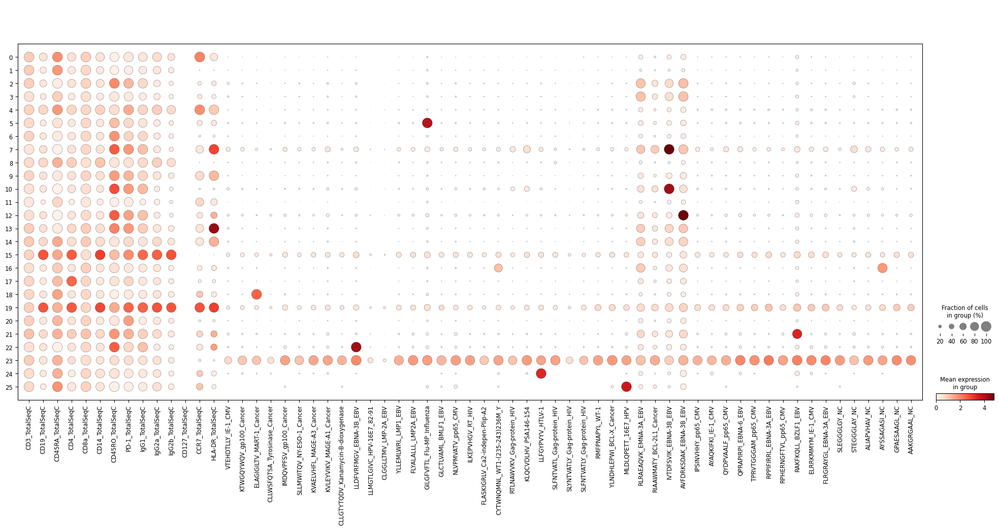

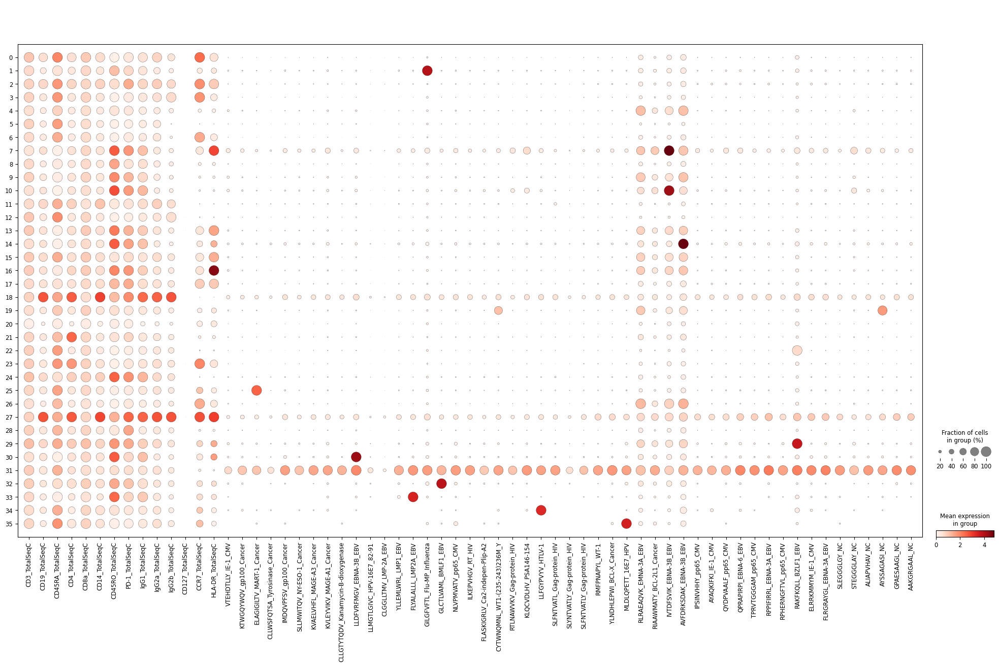

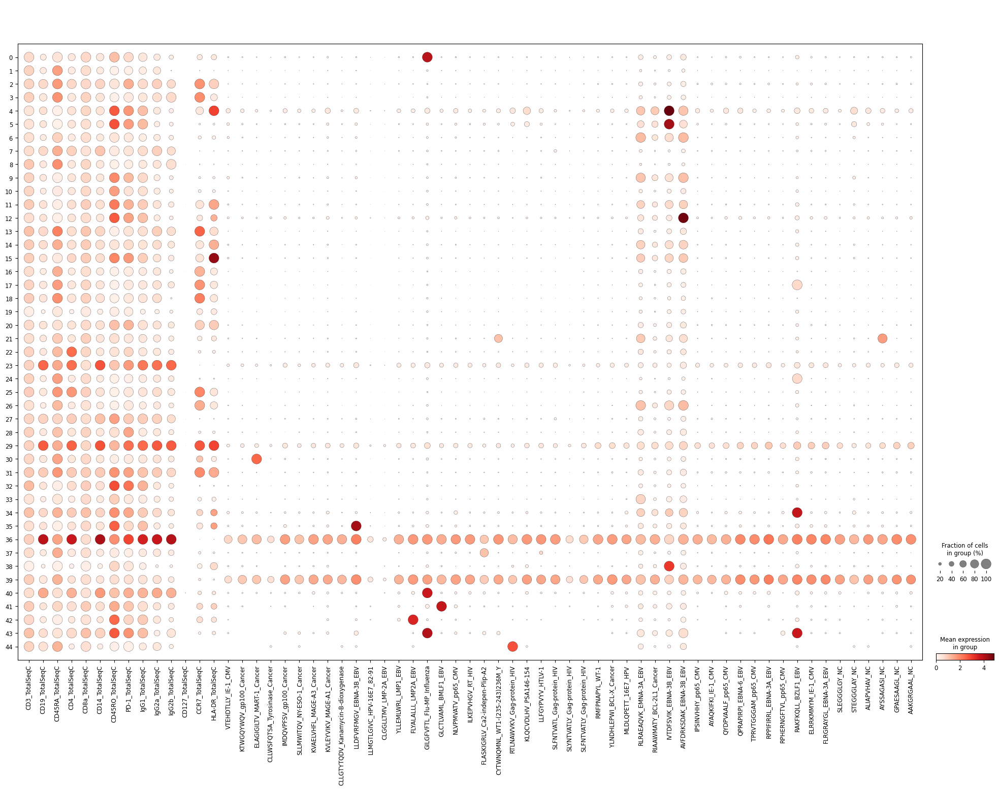

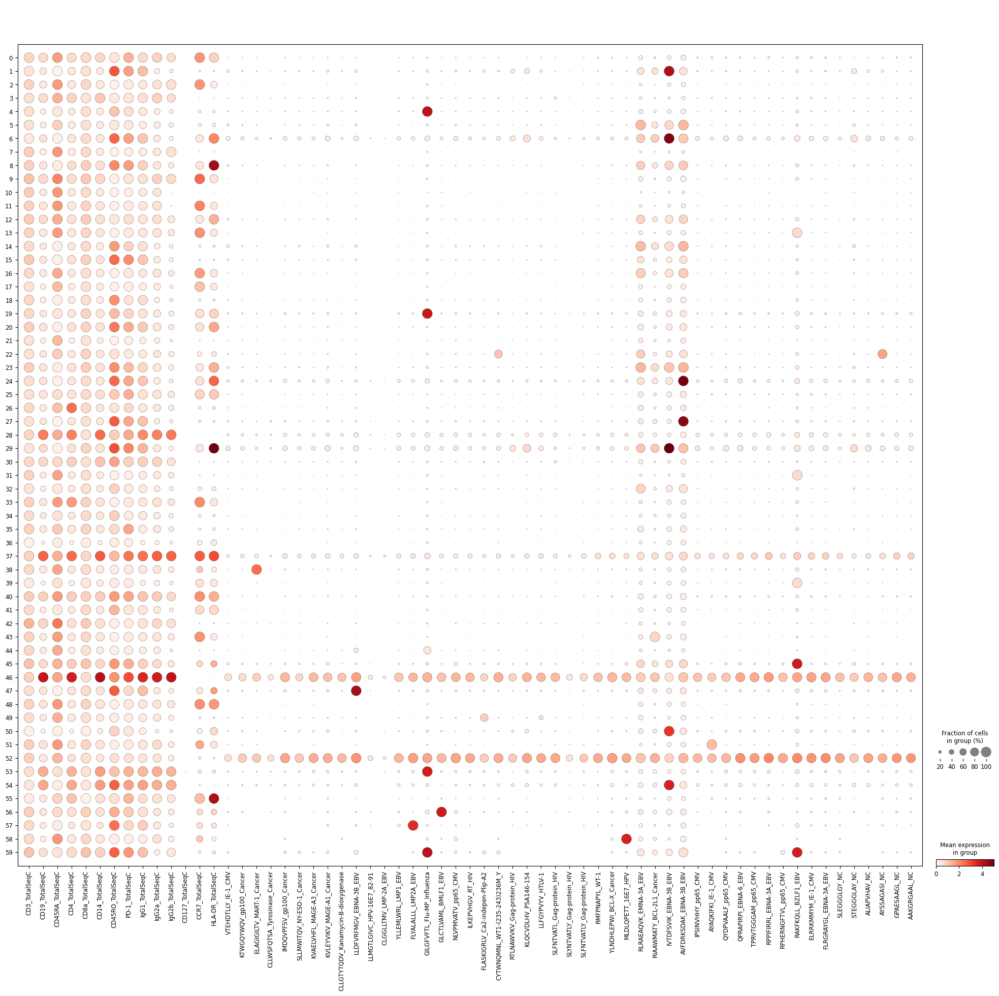

In [76]:
sc.pl.dotplot(prot, prot.var.index, "leiden_res1", save=f'_{donor}_l1.png')
sc.pl.dotplot(prot, prot.var.index, "leiden_res2", save=f'_{donor}_l2.png')
sc.pl.dotplot(prot, prot.var.index, "leiden_res3", save=f'_{donor}_l3.png')
sc.pl.dotplot(prot, prot.var.index, "leiden_res4", save=f'_{donor}_l4.png')


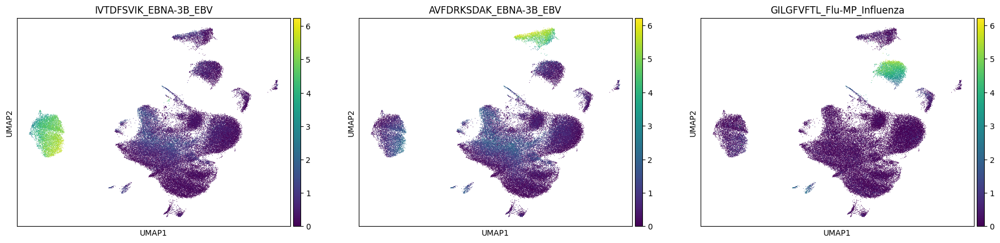

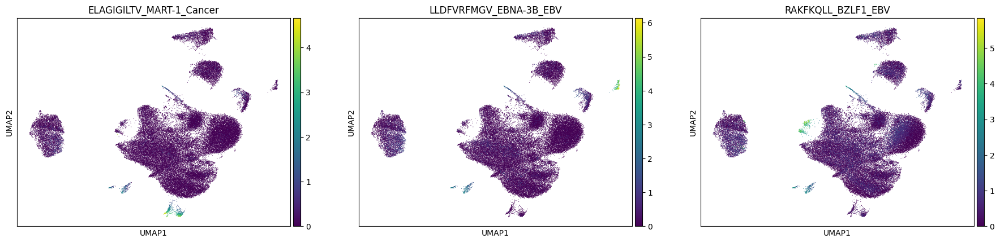

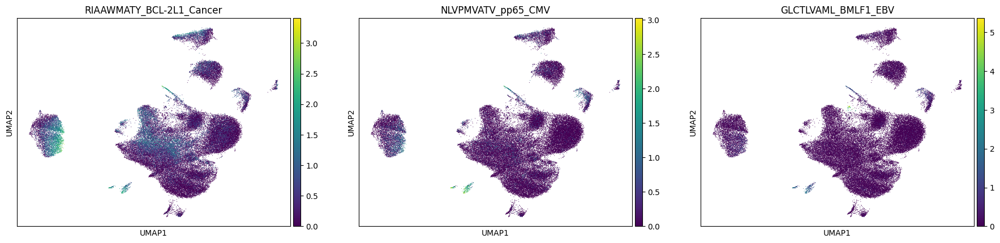

In [11]:
sc.pl.umap(prot, color=['IVTDFSVIK_EBNA-3B_EBV', 'AVFDRKSDAK_EBNA-3B_EBV','GILGFVFTL_Flu-MP_Influenza'])
sc.pl.umap(prot, color=['ELAGIGILTV_MART-1_Cancer', 'LLDFVRFMGV_EBNA-3B_EBV','RAKFKQLL_BZLF1_EBV'])
sc.pl.umap(prot, color=['RIAAWMATY_BCL-2L1_Cancer', 'NLVPMVATV_pp65_CMV','GLCTLVAML_BMLF1_EBV'])

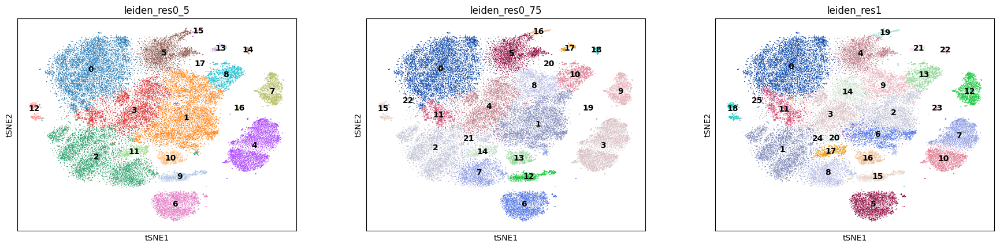

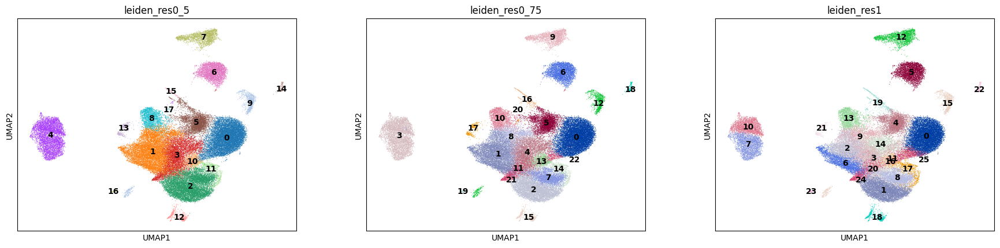

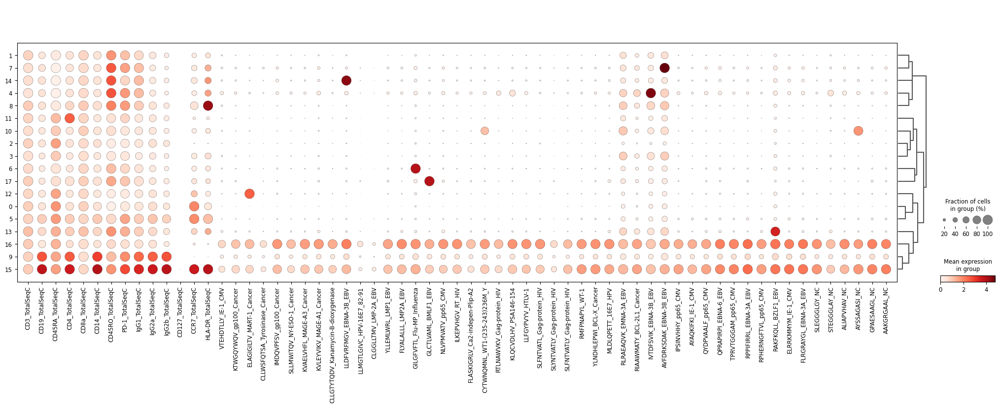

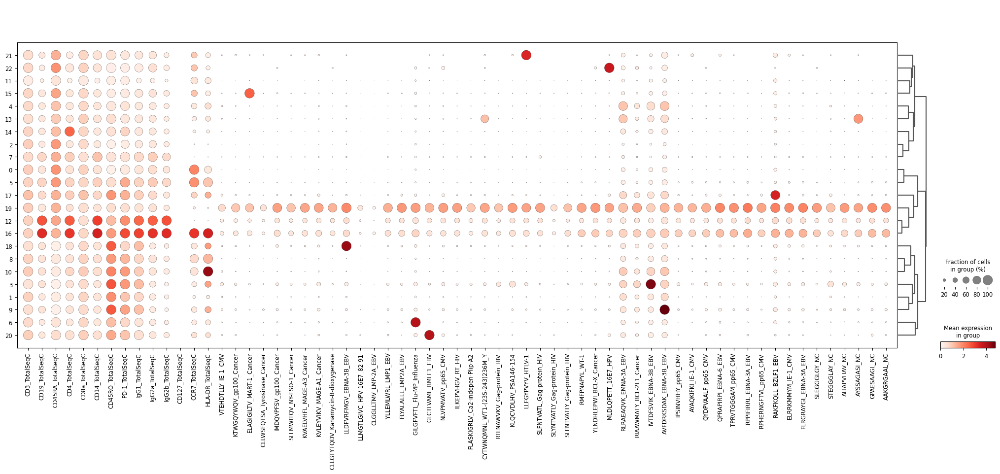

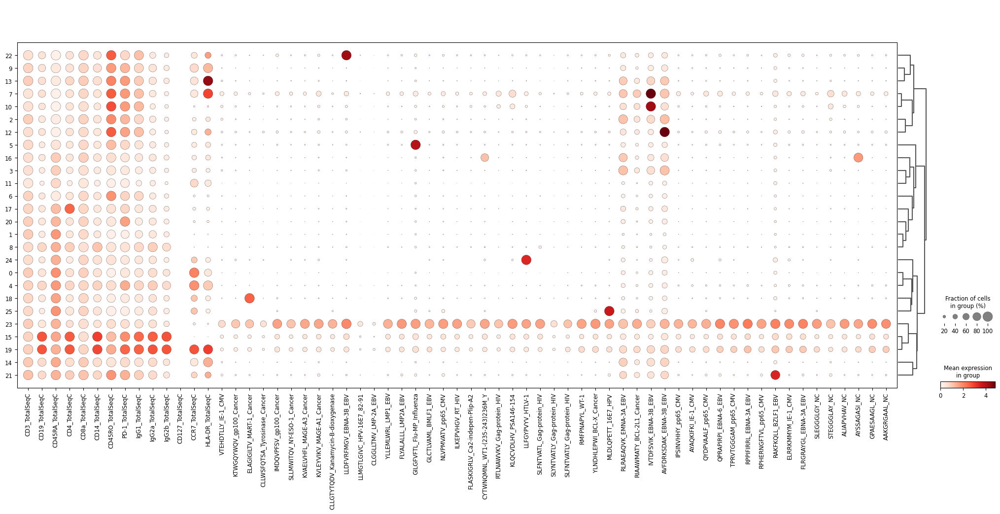

In [14]:
sc.pl.tsne(
    prot,
    color=[ "leiden_res0_5","leiden_res0_75", "leiden_res1"],
    legend_loc="on data",
)
sc.pl.umap(
    prot,
    color=[ "leiden_res0_5","leiden_res0_75", "leiden_res1"],
    legend_loc="on data",
)
sc.pl.dotplot(prot, prot.var.index, "leiden_res0_5", dendrogram=True)
sc.pl.dotplot(prot, prot.var.index, "leiden_res0_75", dendrogram=True)
sc.pl.dotplot(prot, prot.var.index, "leiden_res1", dendrogram=True)

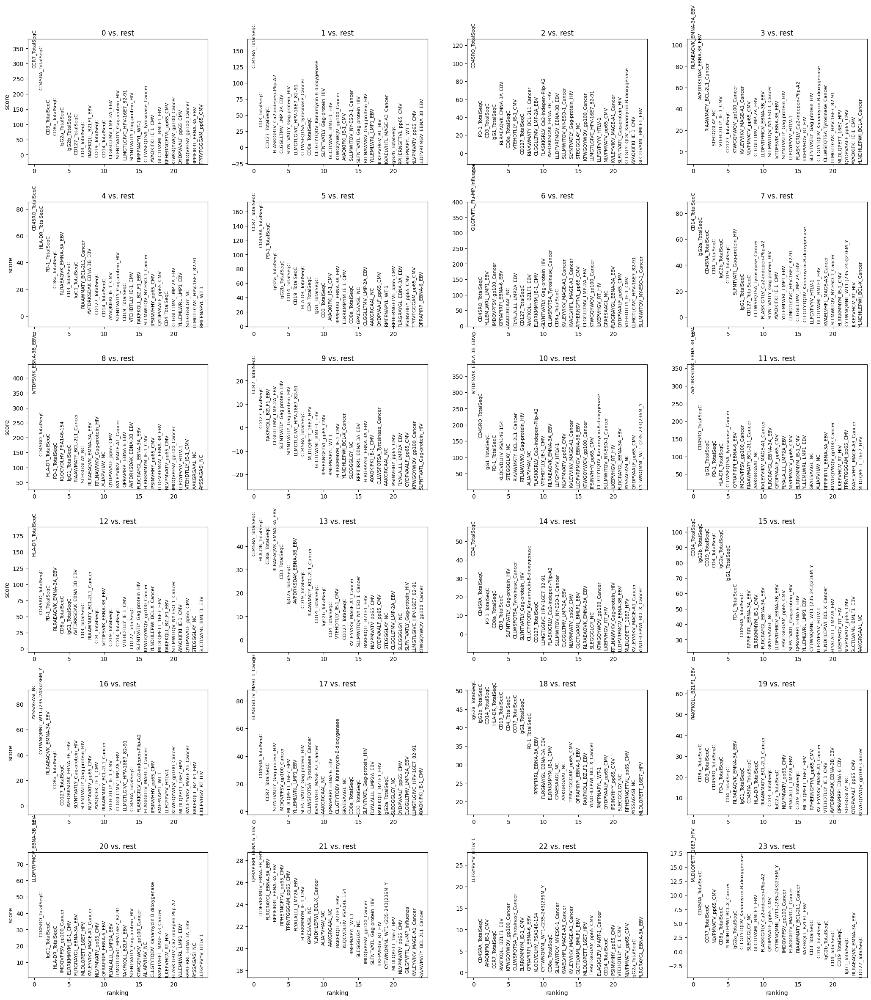

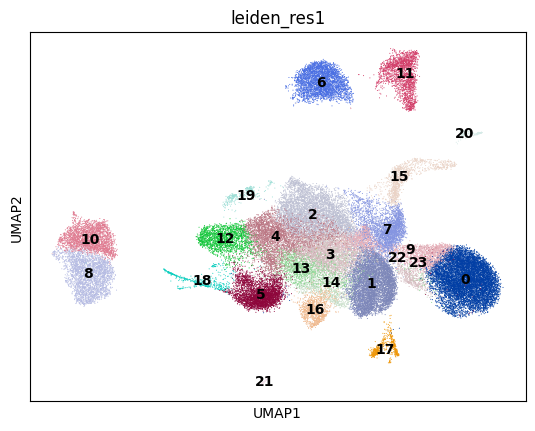

,0_n,0_p,1_n,1_p,2_n,2_p,3_n,3_p,4_n,4_p,5_n,5_p,6_n,6_p,7_n,7_p,8_n,8_p,9_n,9_p,10_n,10_p,11_n,11_p,12_n,12_p,13_n,13_p,14_n,14_p,15_n,15_p,16_n,16_p,17_n,17_p,18_n,18_p,19_n,19_p,20_n,20_p,21_n,21_p,22_n,22_p,23_n,23_p
0,CCR7_TotalSeqC,0.000000e+00,CD45RA_TotalSeqC,0.000000e+00,CD45RO_TotalSeqC,0.000000e+00,RLRAEAQVK_EMNA-3A_EBV,0.000000e+00,CD45RO_TotalSeqC,0.000000e+00,CCR7_TotalSeqC,0.000000e+00,GILGFVFTL_Flu-MP_Influenza,0.000000e+00,CD14_TotalSeqC,0.000000e+00,IVTDFSVIK_EBNA-3B_EBV,0.000000e+00,CCR7_TotalSeqC,4.922099e-47,IVTDFSVIK_EBNA-3B_EBV,0.000000e+00,AVFDRKSDAK_EBNA-3B_EBV,0.000000e+00,HLA-DR_TotalSeqC,0.000000e+00,CD45RA_TotalSeqC,3.723606e-212,CD4_TotalSeqC,2.281388e-246,CD14_TotalSeqC,0.000000e+00,AYSSAGASI_NC,0.000000e+00,ELAGIGILTV_MART-1_Cancer,9.451415e-260,IgG2a_TotalSeqC,1.359090e-164,RAKFKQLL_BZLF1_EBV,2.537583e-144,LLDFVRFMGV_EBNA-3B_EBV,6.280183e-120,QPRAPIRPI_EBNA-6_EBV,7.590087e-36,LLFGYPVYV_HTLV-1,3.488644e-14,MLDLQPETT_16E7_HPV,3.111102e-08
1,CD45RA_TotalSeqC,0.000000e+00,CD3_TotalSeqC,1.505387e-209,PD-1_TotalSeqC,5.701827e-79,AVFDRKSDAK_EBNA-3B_EBV,0.000000e+00,HLA-DR_TotalSeqC,0.000000e+00,CD45RA_TotalSeqC,0.000000e+00,CD45RO_TotalSeqC,7.002831e-44,IgG2a_TotalSeqC,0.000000e+00,CD45RO_TotalSeqC,0.000000e+00,CD127_TotalSeqC,8.743750e-01,CD45RO_TotalSeqC,0.000000e+00,CD45RO_TotalSeqC,0.000000e+00,CD45RO_TotalSeqC,0.000000e+00,HLA-DR_TotalSeqC,1.603765e-196,CD45RA_TotalSeqC,5.746857e-22,IgG2b_TotalSeqC,0.000000e+00,CYTWNQMNL_WT1-(235-243)236M_Y,9.006773e-219,CD45RA_TotalSeqC,1.114282e-89,IgG2b_TotalSeqC,1.323075e-160,CD8a_TotalSeqC,1.273897e-49,CD45RO_TotalSeqC,5.086293e-62,LLDFVRFMGV_EBNA-3B_EBV,1.191945e-32,CD45RA_TotalSeqC,3.285025e-02,CD45RA_TotalSeqC,2.843901e-05
2,CD3_TotalSeqC,0.000000e+00,CD127_TotalSeqC,6.397684e-01,CD3_TotalSeqC,9.627536e-63,RIAAWMATY_BCL-2L1_Cancer,1.710834e-83,PD-1_TotalSeqC,4.409503e-215,PD-1_TotalSeqC,0.000000e+00,YLLEMLWRL_LMP1_EBV,2.872804e-03,CD45RA_TotalSeqC,2.232201e-214,HLA-DR_TotalSeqC,0.000000e+00,RAKFKQLL_BZLF1_EBV,4.963357e-08,IgG1_TotalSeqC,0.000000e+00,IgG1_TotalSeqC,0.000000e+00,PD-1_TotalSeqC,7.153539e-290,CD8a_TotalSeqC,5.885500e-180,PD-1_TotalSeqC,7.642573e-09,CD19_TotalSeqC,0.000000e+00,RLRAEAQVK_EMNA-3A_EBV,1.429649e-110,CCR7_TotalSeqC,7.383667e-15,CD14_TotalSeqC,5.185023e-159,CD3_TotalSeqC,9.290342e-48,IgG1_TotalSeqC,4.706527e-28,FLRGRAYGL_EBNA-3A_EBV,2.778943e-32,AYAQKIFKI_IE-1_CMV,1.512086e-01,CCR7_TotalSeqC,1.258972e-01
3,CD8a_TotalSeqC,0.000000e+00,FLASKIGRLV_Ca2-indepen-Plip-A2,1.727307e-12,IgG1_TotalSeqC,9.697520e-53,STEGGGLAY_NC,1.419320e-07,CD8a_TotalSeqC,1.263360e-92,IgG2a_TotalSeqC,0.000000e+00,IMDQVPFSV_gp100_Cancer,1.032354e-01,CD4_TotalSeqC,2.028297e-213,PD-1_TotalSeqC,0.000000e+00,CLGGLLTMV_LMP-2A_EBV,9.211710e-13,PD-1_TotalSeqC,0.000000e+00,PD-1_TotalSeqC,2.150286e-310,RLRAEAQVK_EMNA-3A_EBV,2.927216e-153,RLRAEAQVK_EMNA-3A_EBV,1.168840e-155,CD8a_TotalSeqC,1.045871e-03,CD4_TotalSeqC,0.000000e+00,CD8a_TotalSeqC,3.313612e-41,SLYNTVATLY_Gag-protein_HIV,5.752969e-01,HLA-DR_TotalSeqC,3.041624e-159,CD45RO_TotalSeqC,5.269500e-35,HLA-DR_TotalSeqC,1.413692e-09,RPPIFIRRL_EBNA-3A_EBV,4.373251e-32,CCR7_TotalSeqC,2.946369e-01,NLVPMVATV_pp65_CMV,1.362531e-01
4,IgG2a_TotalSeqC,1.679905e-209,CLGGLLTMV_LMP-2A_EBV,1.235851e-18,RLRAEAQVK_EMNA-3A_EBV,2.046855e-23,VTEHDTLLY_IE-1_CMV,2.365207e-07,RLRAEAQVK_EMNA-3A_EBV,2.009272e-57,IgG2b_TotalSeqC,2.343094e-284,QPRAPIRPI_EBNA-6_EBV,1.476113e-01,IgG2b_TotalSeqC,7.599525e-185,KLQCVDLHV_PSA146-154,0.000000e+00,SLFNTVATLY_Gag-protein_HIV,1.589040e-19,KLQCVDLHV_PSA146-154,7.238283e-179,HLA-DR_TotalSeqC,2.885560e-60,CD8a_TotalSeqC,5.572242e-111,CD3_TotalSeqC,4.585639e-127,CD3_TotalSeqC,2.451697e-02,IgG2a_TotalSeqC,0.000000e+00,CD127_TotalSeqC,5.854575e-01,IMDQVPFSV_gp100_Cancer,5.803374e-01,CD19_TotalSeqC,5.783186e-153,PD-1_TotalSeqC,2.383381e-30,IMDQVPFSV_gp100_Cancer,4.763390e-05,RPHERNGFTVL_pp65_CMV,1.017154e-31,RAKFKQLL_BZLF1_EBV,4.850131e-01,CD8a_TotalSeqC,2.202445e-01
5,IgG2b_TotalSeqC,1.055732e-44,SLYNTVATLY_G

In [82]:

sc.tl.rank_genes_groups(prot, "leiden_res1", method="t-test")
sc.pl.rank_genes_groups(prot, n_genes=25, sharey=False)
sc.pl.umap(
    prot,
    color=["leiden_res1"],
    legend_loc="on data",
)
result = prot.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.set_option('display.max_columns', 50)
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals']}).head(10)

In [47]:
cl_annotation = {
    #"3": "RLRAEAQVK",
    "6": "GILGFVFTL",
    "8": "IVTDFSVIK",
    "10": "IVTDFSVIK",
    "11":"AVFDRKSDAK",
    "17":"ELAGIGILTV",
    "19":"RAKFKQLL",
    "20":"LLDFVRFMGV",
    "21":"QPRAPIRPI",
    "22":"LLFGYPVYV",
    "23":"MLDLQPETT"
    
}
prot.obs["top_tetramer"] = prot.obs.leiden_res1.map(cl_annotation)

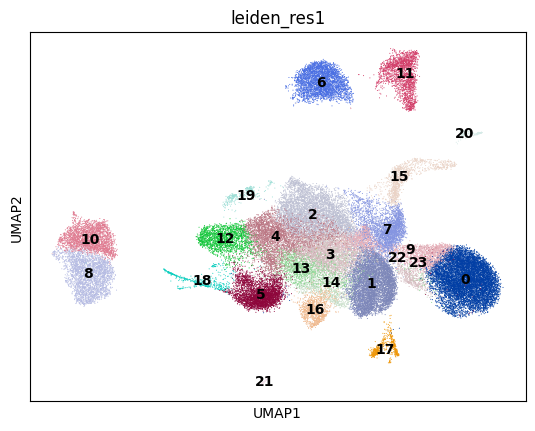

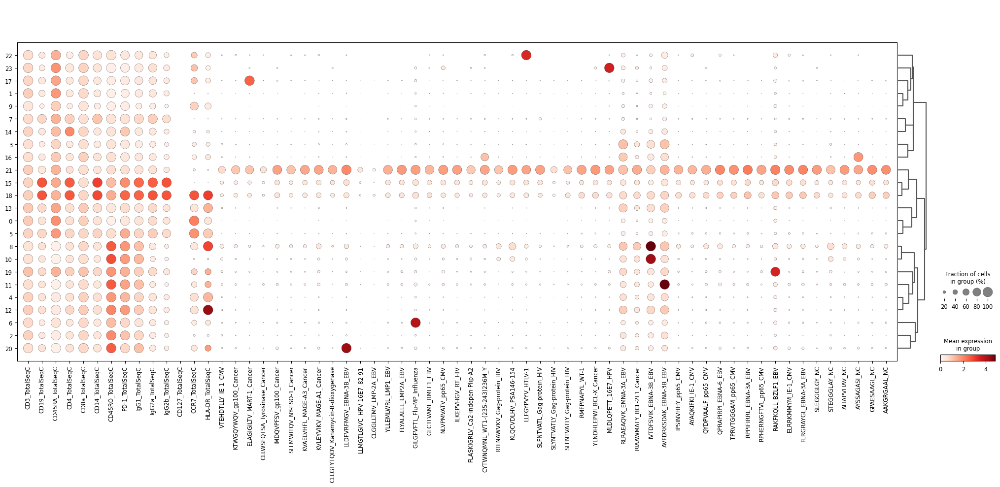

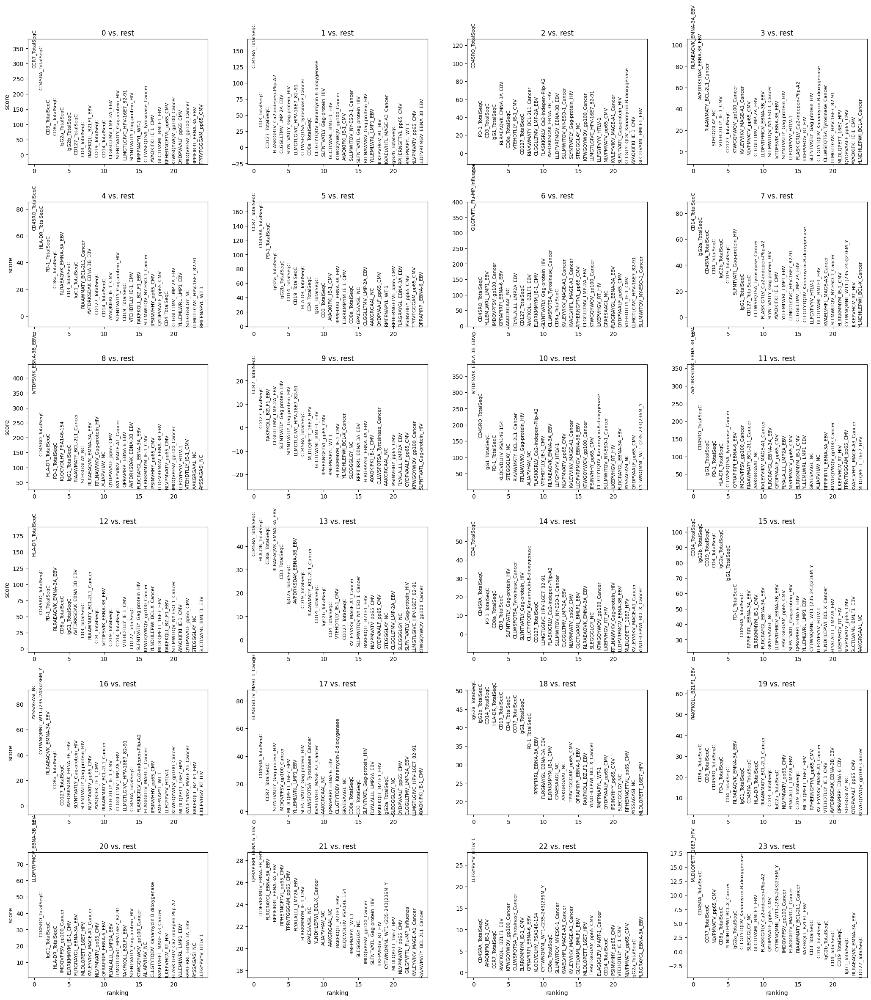

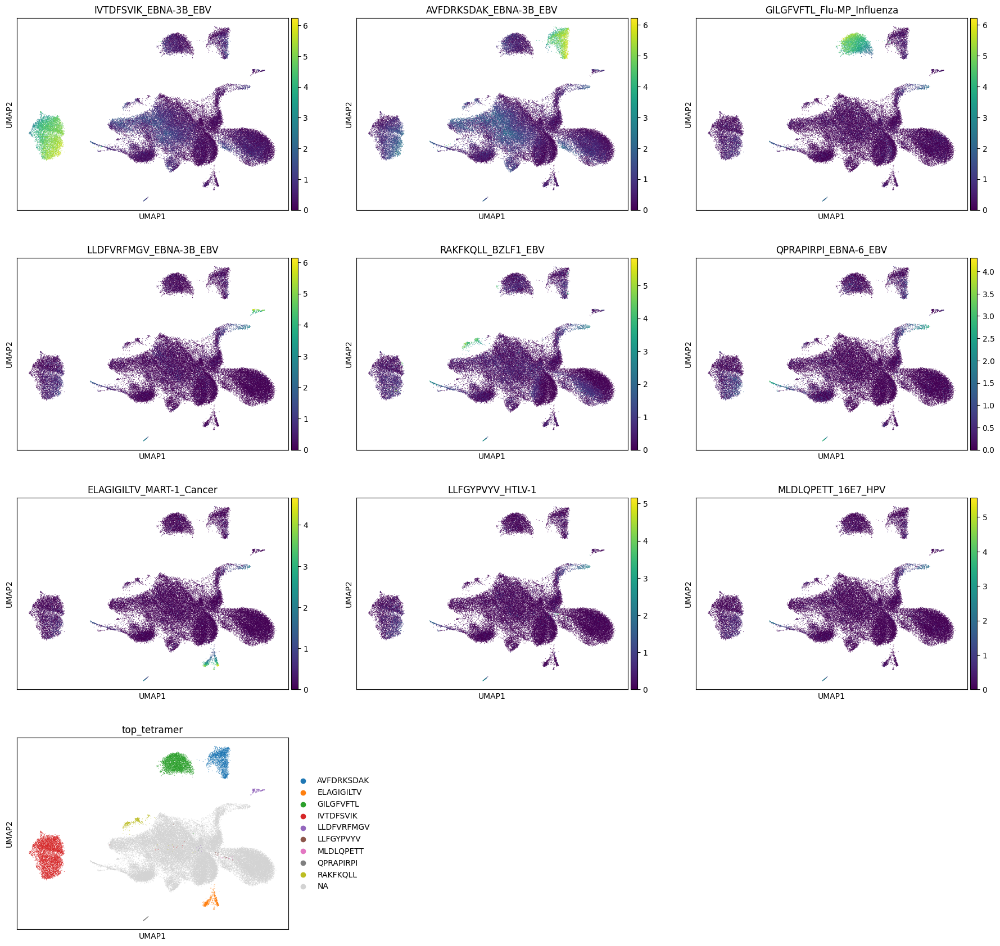

In [84]:
sc.pl.umap(
    prot,
    color=["leiden_res1"],
    legend_loc="on data",
    save=f'_clusters_{donor}.png')
sc.pl.dotplot(prot, prot.var.index, "leiden_res1", dendrogram=True,save=f'_clusters_{donor}.png')

sc.tl.rank_genes_groups(prot, "leiden_res1", method="t-test")
sc.pl.rank_genes_groups(prot, n_genes=25, sharey=False,save=f'_clusters_{donor}.png')

sc.pl.umap(prot, color=['IVTDFSVIK_EBNA-3B_EBV', 'AVFDRKSDAK_EBNA-3B_EBV','GILGFVFTL_Flu-MP_Influenza',
                       'LLDFVRFMGV_EBNA-3B_EBV', 'RAKFKQLL_BZLF1_EBV','QPRAPIRPI_EBNA-6_EBV',
                       'ELAGIGILTV_MART-1_Cancer', 'LLFGYPVYV_HTLV-1','MLDLQPETT_16E7_HPV','top_tetramer'],ncols=3, save = f'_{donor}_top_tetramers_sc.png')

In [ ]:
prot.var.sort_values('n_cells_by_counts').tail(60)

In [ ]:
'GILGFVFTL_Flu-MP_Influenza','IVTDFSVIK_EBNA-3B_EBV','AVFDRKSDAK_EBNA-3B_EBV','ELAGIGILTV_MART-1_Cancer','RAKFKQLL_BZLF1_EBV'
,'LLDFVRFMGV_EBNA-3B_EBV','QPRAPIRPI_EBNA-6_EBV','LLFGYPVYV_HTLV-1','MLDLQPETT_16E7_HPV'

In [52]:
prot.obs[~prot.obs['top_tetramer'].isna()].reset_index().rename({'index':'barcode'},axis=1)[['barcode','top_tetramer']].to_csv('donor1_top_tetramer.csv',index=False)


In [103]:
prot_4 = prot[prot.obs['leiden_res1'].isin(['4'])]
prot_7 = prot[prot.obs['leiden_res0_75'].isin(['7'])]
prot_7 = prot[prot.obs['leiden_res0_75'].isin(['7'])]

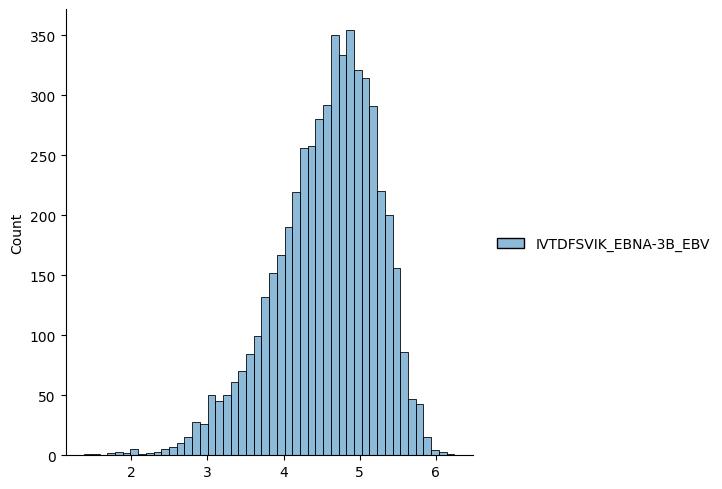

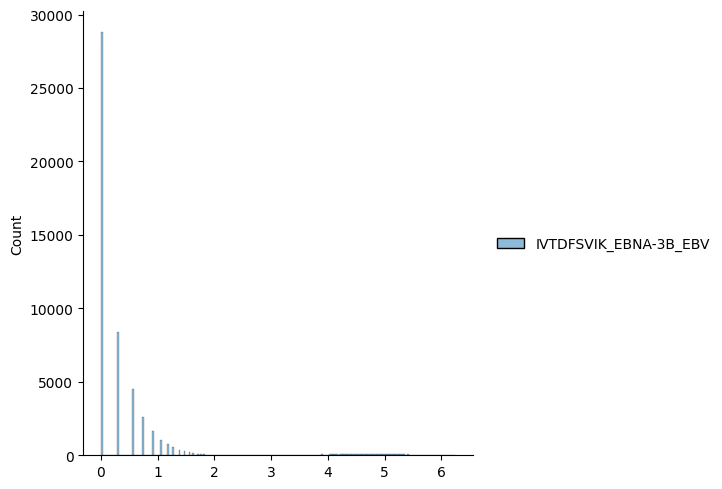

In [129]:
sns.displot(sc.get.obs_df(
        prot_4,
        keys=["IVTDFSVIK_EBNA-3B_EBV"]
    ))
sns.displot(sc.get.obs_df(
        prot,
        keys=["IVTDFSVIK_EBNA-3B_EBV"]
    )).set_titles('among all clusters')

In [102]:
prot[prot.obs['leiden_res0_75']==3]

<0x63 sparse matrix of type '<class 'numpy.float32'>'
	with 0 stored elements in Compressed Sparse Row format>

## Donor 2

In [77]:
donor = 'donor2'

In [78]:
#data_path = '/home/ykremlyakova/projects/tcr_emb/data/10x/healthy/donor1/filtered_feature_bc_matrix'
data_path = f'/home/ykremlyakova/projects/tcr_emb/data/10x/healthy/{donor}/vdj_v1_hs_aggregated_{donor}_filtered_feature_bc_matrix.h5'

In [79]:
mdata = mu.read_10x_h5(data_path)
mdata.shape

(91921, 33602)

In [80]:
mu.pp.intersect_obs(mdata)
mdata.shape

(91921, 33602)

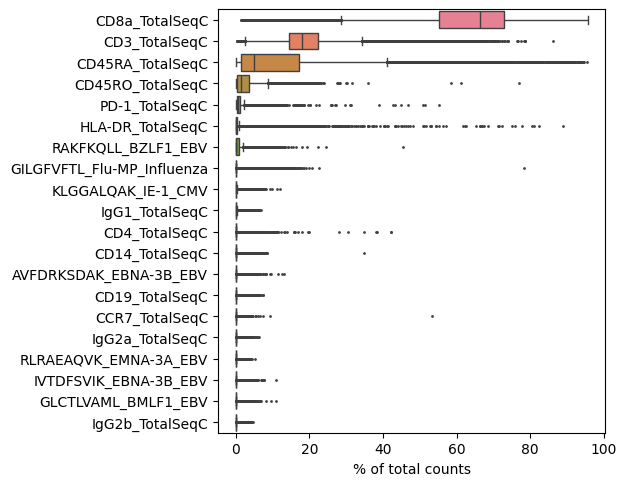

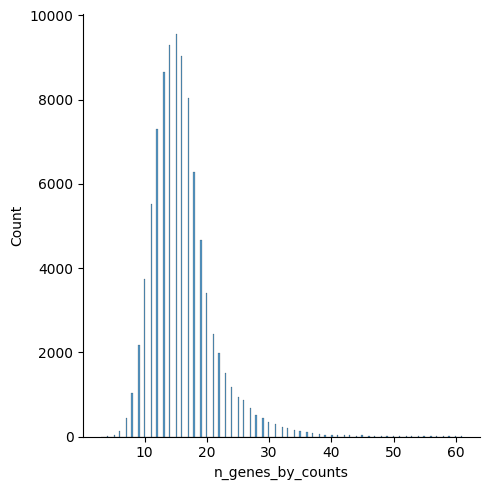

In [81]:
sc.pl.highest_expr_genes(mdata['prot'], n_top=20)
sc.pp.calculate_qc_metrics(mdata["prot"], inplace=True, percent_top=None)
sc.pp.calculate_qc_metrics(mdata["rna"], inplace=True, percent_top=None)
sns.displot(mdata["prot"].obs.n_genes_by_counts)

In [82]:
klg = mdata['prot'].var_names.str.startswith('KLG')
prot = mdata['prot'][:,np.invert(klg)]

In [83]:
mu.prot.pp.clr(prot)

In [84]:
sc.tl.pca(prot)

In [85]:
sc.pp.neighbors(prot)
sc.tl.umap(prot, random_state=1)

In [88]:
sc.tl.leiden(prot, key_added="leiden_res0_5", resolution=0.5)

In [89]:
sc.tl.leiden(prot, key_added="leiden_res0_75", resolution=0.75)

In [90]:
sc.tl.leiden(prot, key_added="leiden_res1", resolution=1.0)

In [91]:
sc.tl.leiden(prot, key_added="leiden_res2", resolution=2.0)

In [92]:
sc.tl.leiden(prot, key_added="leiden_res3", resolution=3.0)

In [93]:
sc.tl.leiden(prot, key_added="leiden_res4", resolution=4.0)

In [86]:
sc.tl.tsne(prot, use_rep="X_pca")

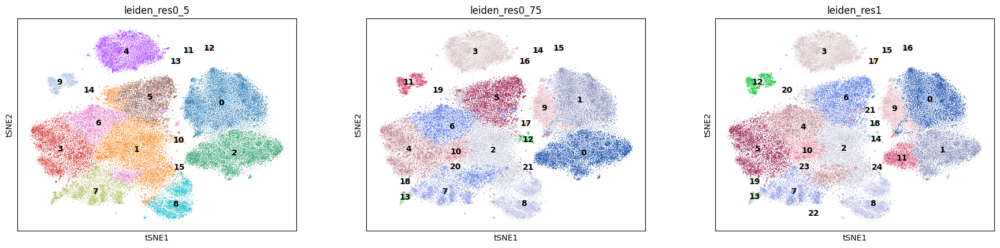

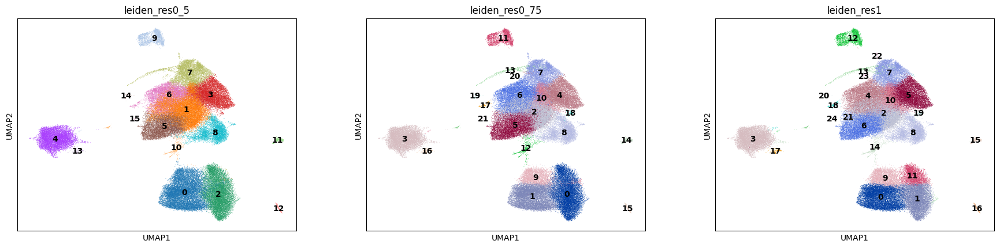

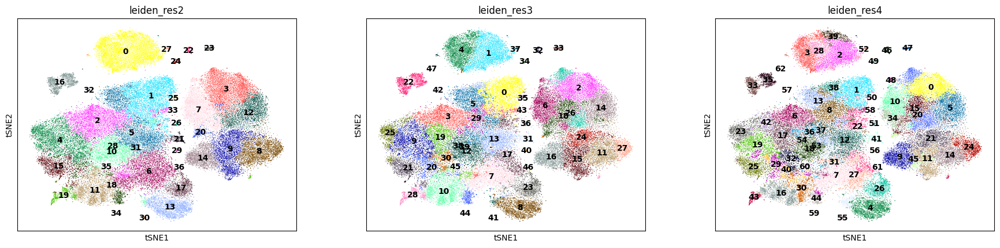

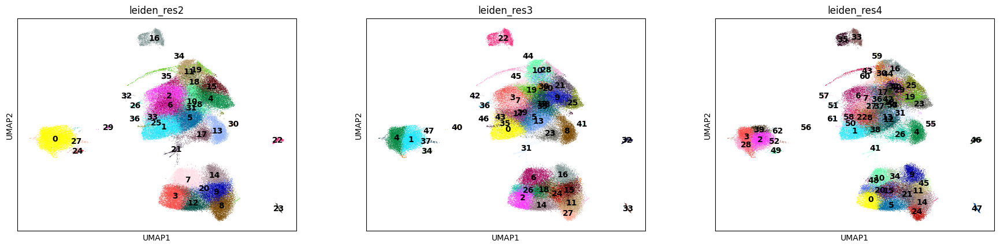

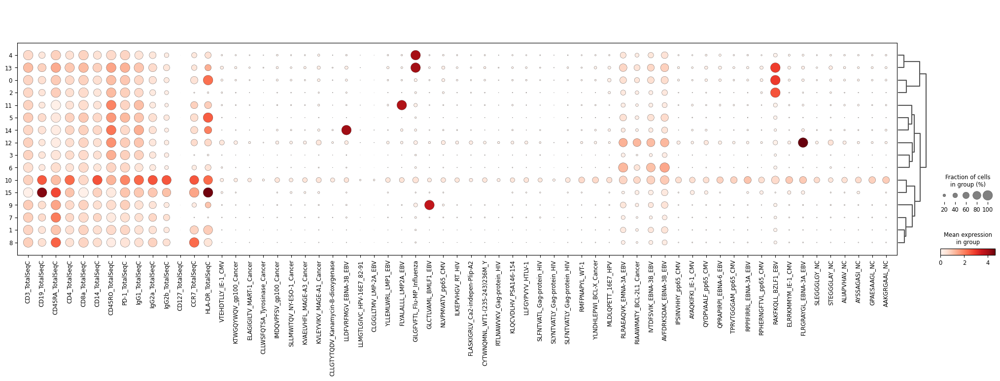

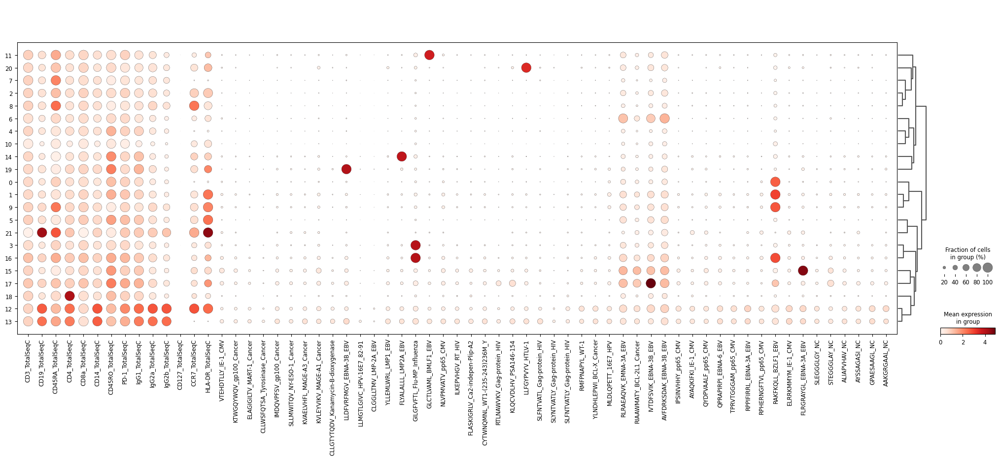

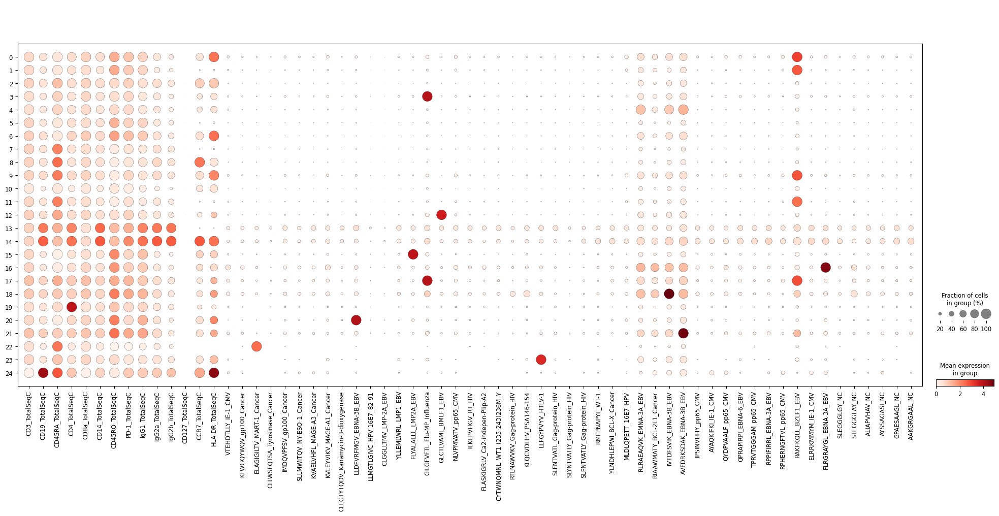

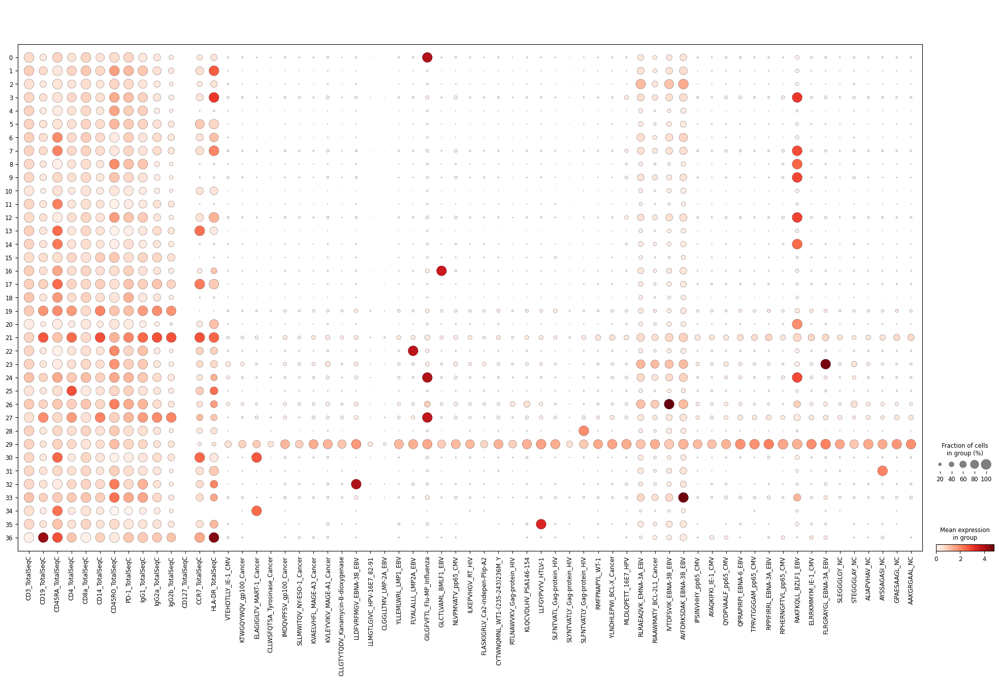

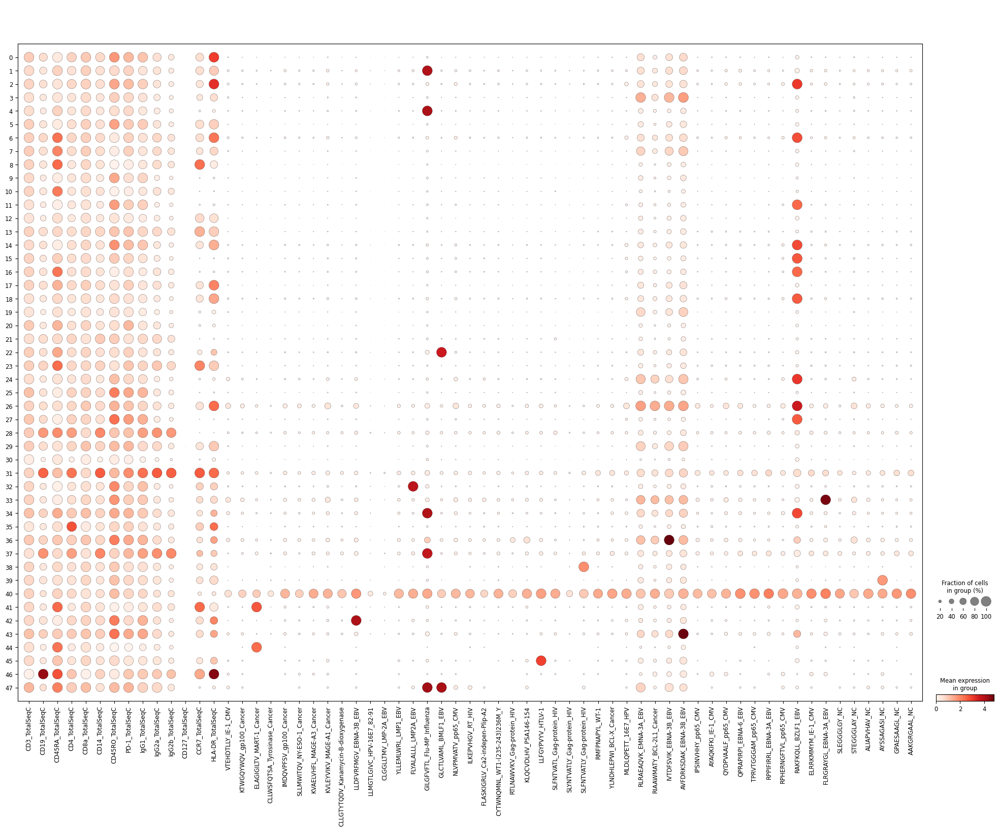

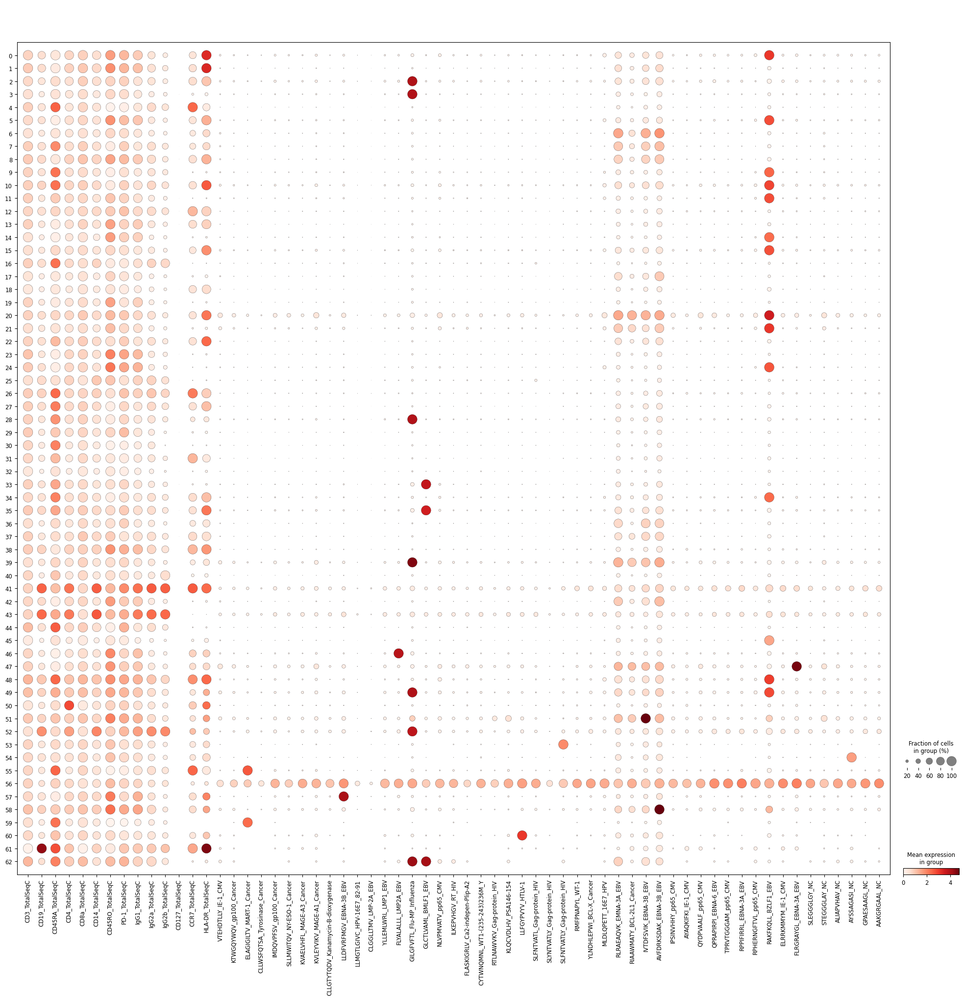

In [103]:
sc.pl.tsne(
    prot,
    color=[ "leiden_res0_5","leiden_res0_75", "leiden_res1"],
    legend_loc="on data",
)
sc.pl.umap(
    prot,
    color=[ "leiden_res0_5","leiden_res0_75", "leiden_res1"],
    legend_loc="on data",
)

sc.pl.tsne(
    prot,
    color=[ "leiden_res2","leiden_res3", "leiden_res4"],
    legend_loc="on data",
)

sc.pl.umap(
    prot,
    color=[ "leiden_res2","leiden_res3", "leiden_res4"],
    legend_loc="on data",
)

sc.pl.dotplot(prot, prot.var.index, "leiden_res0_5", dendrogram=True)
sc.pl.dotplot(prot, prot.var.index, "leiden_res0_75", dendrogram=True)
sc.pl.dotplot(prot, prot.var.index, "leiden_res1", save=f'_{donor}_l1.png')
sc.pl.dotplot(prot, prot.var.index, "leiden_res2", save=f'_{donor}_l2.png')
sc.pl.dotplot(prot, prot.var.index, "leiden_res3", save=f'_{donor}_l3.png')
sc.pl.dotplot(prot, prot.var.index, "leiden_res4", save=f'_{donor}_l4.png')

In [95]:
l = 'leiden_res1'
sc.tl.rank_genes_groups(prot, l, method="t-test")
result = prot.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.set_option('display.max_columns', 50)
t = pd.DataFrame(
    {group: result['names'][group]
    for group in groups}).head(1).T.rename({0:'top_tetramer'},axis=1)
t = t.reset_index().rename({'index':l},axis=1)

t2 = pd.DataFrame(
    {group: result['pvals'][group]
    for group in groups}).head(1).T.rename({0:'pvals'},axis=1)
t2 = t2.reset_index().rename({'index':l},axis=1)
prot.obs.rename({'n_genes_by_counts':'cluster_size'},axis=1).groupby(l).count()['cluster_size'].reset_index().merge(t).merge(t2)

,leiden_res1,cluster_size,top_tetramer,pvals
0,0,11214,RAKFKQLL_BZLF1_EBV,0.000000e+00
1,1,9263,RAKFKQLL_BZLF1_EBV,0.000000e+00
2,2,9236,CCR7_TotalSeqC,0.000000e+00
3,3,9225,GILGFVFTL_Flu-MP_Influenza,0.000000e+00
4,4,9170,AVFDRKSDAK_EBNA-3B_EBV,0.000000e+00
5,5,8920,CD45RO_TotalSeqC,0.000000e+00
6,6,8720,HLA-DR_TotalSeqC,0.000000e+00
7,7,5569,CD45RA_TotalSeqC,0.000000e+00
8,8,5345,CD45RA_TotalSeqC,0.000000e+00
9,9,4119,RAKFKQLL_BZLF1_EBV,0.000000e+00


In [96]:
l = 'leiden_res2'
sc.tl.rank_genes_groups(prot, l, method="t-test")
result = prot.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.set_option('display.max_columns', 50)
t = pd.DataFrame(
    {group: result['names'][group]
    for group in groups}).head(1).T.rename({0:'top_tetramer'},axis=1)
t = t.reset_index().rename({'index':l},axis=1)

t2 = pd.DataFrame(
    {group: result['pvals'][group]
    for group in groups}).head(1).T.rename({0:'pvals'},axis=1)
t2 = t2.reset_index().rename({'index':l},axis=1)
prot.obs.rename({'n_genes_by_counts':'cluster_size'},axis=1).groupby(l).count()['cluster_size'].reset_index().merge(t).merge(t2)

,leiden_res2,cluster_size,top_tetramer,pvals
0,0,9163,GILGFVFTL_Flu-MP_Influenza,0.000000e+00
1,1,7145,HLA-DR_TotalSeqC,0.000000e+00
2,2,6602,AVFDRKSDAK_EBNA-3B_EBV,0.000000e+00
3,3,6247,RAKFKQLL_BZLF1_EBV,0.000000e+00
4,4,5983,CD45RO_TotalSeqC,0.000000e+00
5,5,5940,CCR7_TotalSeqC,0.000000e+00
6,6,5812,CD45RA_TotalSeqC,0.000000e+00
7,7,4847,RAKFKQLL_BZLF1_EBV,0.000000e+00
8,8,4753,RAKFKQLL_BZLF1_EBV,0.000000e+00
9,9,4634,RAKFKQLL_BZLF1_EBV,0.000000e+00


In [98]:
l = 'leiden_res3'
sc.tl.rank_genes_groups(prot, l, method="t-test")
result = prot.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.set_option('display.max_columns', 50)
t = pd.DataFrame(
    {group: result['names'][group]
    for group in groups}).head(1).T.rename({0:'top_tetramer'},axis=1)
t = t.reset_index().rename({'index':l},axis=1)

t2 = pd.DataFrame(
    {group: result['pvals'][group]
    for group in groups}).head(1).T.rename({0:'pvals'},axis=1)
t2 = t2.reset_index().rename({'index':l},axis=1)
prot.obs.rename({'n_genes_by_counts':'cluster_size'},axis=1).groupby(l).count()['cluster_size'].reset_index().merge(t).merge(t2)

,leiden_res3,cluster_size,top_tetramer,pvals
0,0,4969,HLA-DR_TotalSeqC,0.000000e+00
1,1,4831,GILGFVFTL_Flu-MP_Influenza,0.000000e+00
2,2,4398,RAKFKQLL_BZLF1_EBV,0.000000e+00
3,3,4299,AVFDRKSDAK_EBNA-3B_EBV,0.000000e+00
4,4,4285,GILGFVFTL_Flu-MP_Influenza,0.000000e+00
5,5,3852,CD45RO_TotalSeqC,0.000000e+00
6,6,3800,RAKFKQLL_BZLF1_EBV,0.000000e+00
7,7,3744,CD45RA_TotalSeqC,0.000000e+00
8,8,3564,CD45RA_TotalSeqC,0.000000e+00
9,9,3463,CD45RO_TotalSeqC,0.000000e+00


In [101]:
pd.set_option('display.max_rows', 100)

In [102]:
l = 'leiden_res4'
sc.tl.rank_genes_groups(prot, l, method="t-test")
result = prot.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.set_option('display.max_columns', 50)
t = pd.DataFrame(
    {group: result['names'][group]
    for group in groups}).head(1).T.rename({0:'top_tetramer'},axis=1)
t = t.reset_index().rename({'index':l},axis=1)

t2 = pd.DataFrame(
    {group: result['pvals'][group]
    for group in groups}).head(1).T.rename({0:'pvals'},axis=1)
t2 = t2.reset_index().rename({'index':l},axis=1)
prot.obs.rename({'n_genes_by_counts':'cluster_size'},axis=1).groupby(l).count()['cluster_size'].reset_index().merge(t).merge(t2).head(63)

,leiden_res4,cluster_size,top_tetramer,pvals
0,0,3689,RAKFKQLL_BZLF1_EBV,0.000000e+00
1,1,3585,HLA-DR_TotalSeqC,0.000000e+00
2,2,3448,GILGFVFTL_Flu-MP_Influenza,0.000000e+00
3,3,3256,GILGFVFTL_Flu-MP_Influenza,0.000000e+00
4,4,3208,CD45RA_TotalSeqC,0.000000e+00
5,5,3099,RAKFKQLL_BZLF1_EBV,0.000000e+00
6,6,3059,AVFDRKSDAK_EBNA-3B_EBV,0.000000e+00
7,7,2827,CD45RA_TotalSeqC,0.000000e+00
8,8,2808,CD8a_TotalSeqC,0.000000e+00
9,9,2771,RAKFKQLL_BZLF1_EBV,0.000000e+00


In [114]:
list(prot.var.iloc[14:57].index)

l = 'leiden_res2'
sc.tl.rank_genes_groups(prot, l, method="t-test")
result = prot.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.set_option('display.max_columns', 50)
t = pd.DataFrame(
    {group: result['names'][group]
    for group in groups}).head(1).T.rename({0:'top_tetramer'},axis=1)
t = t.reset_index().rename({'index':l},axis=1)

t2 = pd.DataFrame(
    {group: result['pvals'][group]
    for group in groups}).head(1).T.rename({0:'pvals'},axis=1)
t2 = t2.reset_index().rename({'index':l},axis=1)
prot.obs.rename({'n_genes_by_counts':'cluster_size'},axis=1).groupby(l).count()['cluster_size'].reset_index().merge(t).merge(t2)

Index(['VTEHDTLLY_IE-1_CMV', 'KTWGQYWQV_gp100_Cancer',
       'ELAGIGILTV_MART-1_Cancer', 'CLLWSFQTSA_Tyrosinase_Cancer',
       'IMDQVPFSV_gp100_Cancer', 'SLLMWITQV_NY-ESO-1_Cancer',
       'KVAELVHFL_MAGE-A3_Cancer', 'KVLEYVIKV_MAGE-A1_Cancer',
       'CLLGTYTQDV_Kanamycin-B-dioxygenase', 'LLDFVRFMGV_EBNA-3B_EBV',
       'LLMGTLGIVC_HPV-16E7_82-91', 'CLGGLLTMV_LMP-2A_EBV',
       'YLLEMLWRL_LMP1_EBV', 'FLYALALLL_LMP2A_EBV',
       'GILGFVFTL_Flu-MP_Influenza', 'GLCTLVAML_BMLF1_EBV',
       'NLVPMVATV_pp65_CMV', 'ILKEPVHGV_RT_HIV',
       'FLASKIGRLV_Ca2-indepen-Plip-A2', 'CYTWNQMNL_WT1-(235-243)236M_Y',
       'RTLNAWVKV_Gag-protein_HIV', 'KLQCVDLHV_PSA146-154', 'LLFGYPVYV_HTLV-1',
       'SLFNTVATL_Gag-protein_HIV', 'SLYNTVATLY_Gag-protein_HIV',
       'SLFNTVATLY_Gag-protein_HIV', 'RMFPNAPYL_WT-1',
       'YLNDHLEPWI_BCL-X_Cancer', 'MLDLQPETT_16E7_HPV',
       'RLRAEAQVK_EMNA-3A_EBV', 'RIAAWMATY_BCL-2L1_Cancer',
       'IVTDFSVIK_EBNA-3B_EBV', 'AVFDRKSDAK_EBNA-3B_EBV', 'IPSINVHHY_p

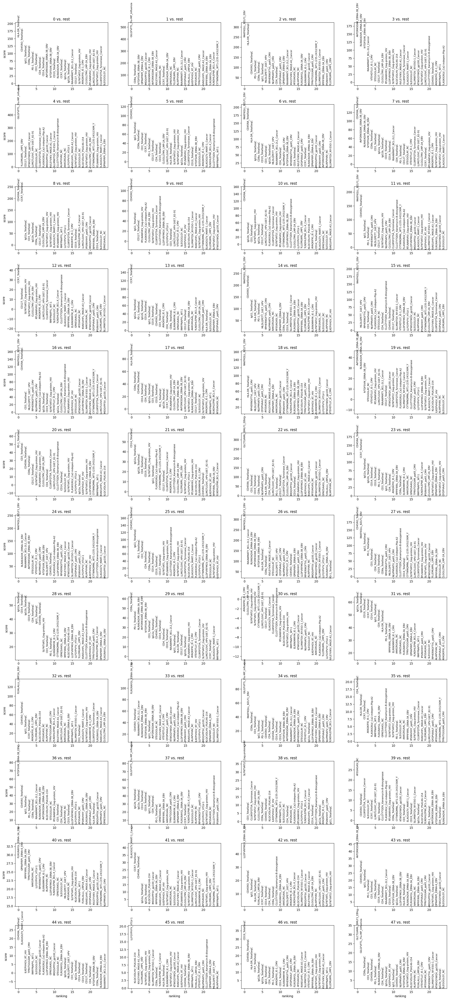

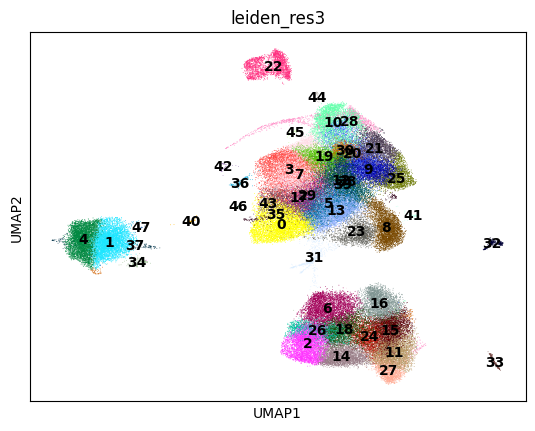

,0_n,0_p,1_n,1_p,2_n,2_p,3_n,3_p,4_n,4_p,5_n,5_p,6_n,6_p,7_n,7_p,8_n,8_p,9_n,9_p,10_n,10_p,11_n,11_p,12_n,...,35_p,36_n,36_p,37_n,37_p,38_n,38_p,39_n,39_p,40_n,40_p,41_n,41_p,42_n,42_p,43_n,43_p,44_n,44_p,45_n,45_p,46_n,46_p,47_n,47_p
0,HLA-DR_TotalSeqC,0.000000e+00,GILGFVFTL_Flu-MP_Influenza,0.000000e+00,RAKFKQLL_BZLF1_EBV,0.000000e+00,AVFDRKSDAK_EBNA-3B_EBV,0.000000e+00,GILGFVFTL_Flu-MP_Influenza,0.000000,CD45RO_TotalSeqC,0.000000e+00,RAKFKQLL_BZLF1_EBV,0.000000e+00,CD45RA_TotalSeqC,0.000000e+00,CD45RA_TotalSeqC,0.000000e+00,CD45RO_TotalSeqC,0.000000e+00,CD45RA_TotalSeqC,0.000000e+00,RAKFKQLL_BZLF1_EBV,0.000000e+00,CCR7_TotalSeqC,...,4.434662e-34,IVTDFSVIK_EBNA-3B_EBV,1.749007e-103,GILGFVFTL_Flu-MP_Influenza,4.923808e-95,SLFNTVATLY_Gag-protein_HIV,7.331528e-44,AYSSAGASI_NC,8.090590e-34,FLRGRAYGL_EBNA-3A_EBV,6.399239e-38,ELAGIGILTV_MART-1_Cancer,3.410207e-41,LLDFVRFMGV_EBNA-3B_EBV,7.795524e-35,AVFDRKSDAK_EBNA-3B_EBV,5.309881e-33,CD45RA_TotalSeqC,1.500563e-19,LLFGYPVYV_HTLV-1,3.045916e-16,CD19_TotalSeqC,5.203882e-14,GLCTLVAML_BMLF1_EBV,6.131550e-10
1,CD45RO_TotalSeqC,0.000000e+00,CD8a_TotalSeqC,5.243059e-201,HLA-DR_TotalSeqC,0.000000e+00,RLRAEAQVK_EMNA-3A_EBV,0.000000e+00,YLLEMLWRL_LMP1_EBV,0.000324,IgG1_TotalSeqC,0.000000e+00,CD45RA_TotalSeqC,0.000000e+00,AVFDRKSDAK_EBNA-3B_EBV,0.000000e+00,CCR7_TotalSeqC,0.000000e+00,IgG1_TotalSeqC,8.997140e-97,IgG2b_TotalSeqC,2.444219e-12,CD45RO_TotalSeqC,0.000000e+00,CD127_TotalSeqC,...,5.841651e-15,CD45RO_TotalSeqC,7.160183e-53,IgG2b_TotalSeqC,4.142215e-48,CD3_TotalSeqC,3.625813e-01,CD45RO_TotalSeqC,4.561950e-02,QPRAPIRPI_EBNA-6_EBV,1.632710e-34,CCR7_TotalSeqC,3.212641e-33,CD45RO_TotalSeqC,9.896551e-14,CD45RO_TotalSeqC,2.399125e-21,ELAGIGILTV_MART-1_Cancer,1.177620e-17,KLQCVDLHV_PSA146-154,8.978688e-02,CD45RA_TotalSeqC,1.557255e-10,GILGFVFTL_Flu-MP_Influenza,9.330944e-09
2,IgG1_TotalSeqC,0.000000e+00,IVTDFSVIK_EBNA-3B_EBV,2.036511e-113,CD45RO_TotalSeqC,0.000000e+00,IVTDFSVIK_EBNA-3B_EBV,0.000000e+00,CD127_TotalSeqC,0.265549,CD8a_TotalSeqC,2.873826e-159,HLA-DR_TotalSeqC,0.000000e+00,RLRAEAQVK_EMNA-3A_EBV,6.295805e-299,IgG2a_TotalSeqC,7.822438e-116,CD127_TotalSeqC,3.721377e-01,CD3_TotalSeqC,2.197313e-10,IgG1_TotalSeqC,9.541276e-234,SLYNTVATLY_Gag-protein_HIV,...,7.310590e-12,IgG1_TotalSeqC,2.964633e-37,IgG2a_TotalSeqC,1.114895e-46,CLLWSFQTSA_Tyrosinase_Cancer,4.374893e-01,CLLWSFQTSA_Tyrosinase_Cancer,1.758148e-01,RPPIFIRRL_EBNA-3A_EBV,2.999484e-32,CD45RA_TotalSeqC,1.068529e-27,IgG1_TotalSeqC,3.811469e-10,IgG1_TotalSeqC,1.053294e-18,ILKEPVHGV_RT_HIV,8.907222e-01,KVLEYVIKV_MAGE-A1_Cancer,1.655140e-01,HLA-DR_TotalSeqC,9.881315e-09,CD8a_TotalSeqC,3.693070e-05
3,CD8a_TotalSeqC,0.000000e+00,QPRAPIRPI_EBNA-6_EBV,2.800618e-104,PD-1_TotalSeqC,0.000000e+00,RIAAWMATY_BCL-2L1_Cancer,4.143437e-243,KTWGQYWQV_gp100_Cancer,0.662071,CD3_TotalSeqC,4.554530e-129,IgG2a_TotalSeqC,2.949937e-210,IVTDFSVIK_EBNA-3B_EBV,3.651607e-288,CD3_TotalSeqC,1.753560e-75,RTLNAWVKV_Gag-protein_HIV,6.133805e-02,SLFNTVATL_Gag-protein_HIV,4.426666e-03,PD-1_TotalSeqC,7.423050e-20,SLFNTVATLY_Gag-protein_HIV,...,5.899243e-03,PD-1_TotalSeqC,8.619902e-26,CD14_TotalSeqC,1.041684e-45,SLYNTVATLY_Gag-protein_HIV,4.992572e-01,SLEGGGLGY_NC,3.937250e-01,TPRVTGGGAM_pp65_CMV,1.187326e-31,IgG2a_TotalSeqC,1.173752e-02,HLA-DR_TotalSeqC,1.235906e-04,PD-1_TotalSeqC,4.344464e-10,TPRVTGGGAM_pp65_CMV,9.853508e-01,YLLEMLWRL_LMP1_EBV,2.294277e-01,CCR7_TotalSeqC,8.598978e-08,CD3_TotalSeqC,4.909621e-04
4,PD-1_TotalSeqC,0.000000e+00,IMDQVPFSV_gp100_Cancer,1.281190e-80,CD8a_TotalSeqC,9.527425e-223,VTEHDTLLY_IE-1_CMV,1.288854e-08,LLMGTLGIVC_HPV-16E7_82-91,0.983283,CCR7_TotalSeqC,4.918527e-94,CD8a_TotalSeqC,9.433064e-178,CD8a_TotalSeqC,1.350441e-241,IgG2b_TotalSeqC,2.284795e-44,FLASKIGRLV_Ca2-indepen-Plip-A2,5.322195e-02,IgG2a_TotalSeqC,5.033975e-03,RPHERNGFTVL_pp65_CMV,2.013347e-05,CLGGLLTMV_LMP-2A_EBV,...,1.080165e-01,CD8a_TotalSeqC,1.088092e-23,CD19_TotalSeqC,2.090780e-42,CLGGLLTMV_LMP-2A_EBV,5.151171e-01,CCR7_TotalSeqC,4.227680e-01,AAKGRGAAL_NC,1.598362e-2

In [105]:

sc.tl.rank_genes_groups(prot, "leiden_res3", method="t-test")
sc.pl.rank_genes_groups(prot, n_genes=25, sharey=False)
sc.pl.umap(
    prot,
    color=["leiden_res3"],
    legend_loc="on data",
)
result = prot.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.set_option('display.max_columns', 50)
pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals']}).head(10)

In [23]:
cl_annotation = {'0':'RAKFKQLL',
                 '1':'RAKFKQLL',
                 '5':'GILGFVFTL',
                 '6':'AVFDRKSDAK',
                 '9':'RAKFKQLL',                 
                 '11':'GLCTLVAML',
                 '14':'FLYALALLL',
                 '15':'FLRGRAYGL',
                 '16':'GILGFVFTL',
                 '17':'IVTDFSVIK',
                 '19':'LLDFVRFMGV',
                 '20':'AVFDRKSDAK',                 
                 '22':'LLFGYPVYV'
                 
}
prot.obs["top_tetramer"] = prot.obs.leiden_res1.map(cl_annotation)

In [24]:
prot.obs

,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,leiden_res0_5,leiden_res0_75,leiden_res1,top_tetramer
AAACCTGAGGGCATGT-1,8,2.197225,2836.0,7.950502,7,7,7,NaN
AAACCTGCAGGATCGA-1,10,2.397895,6273.0,8.744169,1,2,2,NaN
AAACCTGGTTGAGGTG-1,14,2.708050,3295.0,8.100465,1,2,2,NaN
AAACGGGAGCAAATCA-1,14,2.708050,1248.0,7.130098,6,6,6,AVFDRKSDAK
AAACGGGCAGTTCCCT-1,20,3.044522,4217.0,8.347116,6,6,6,AVFDRKSDAK
...,...,...,...,...,...,...,...,...
TTTGTCACACGCATCG-40,20,3.044522,6538.0,8.785540,8,8,8,NaN
TTTGTCACATGTAGTC-40,16,2.833213,5659.0,8.641179,8,8,8,NaN
TTTGTCAGTATCAGTC-40,38,3.663562,9783.0,9.188503,12,15,15,FLRGRAYGL
TTTGTCATCAAAGACA-40,13,2.639057,1415.0,7.255591,3,3,3,NaN


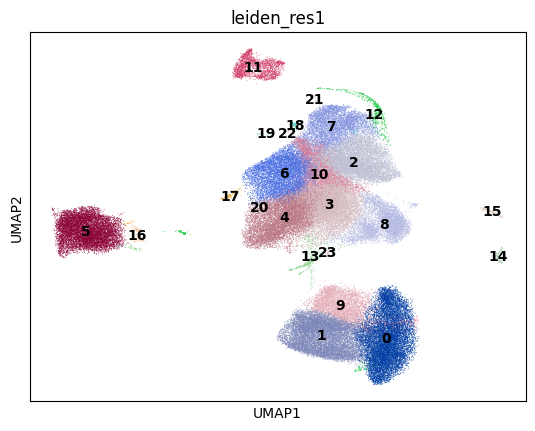

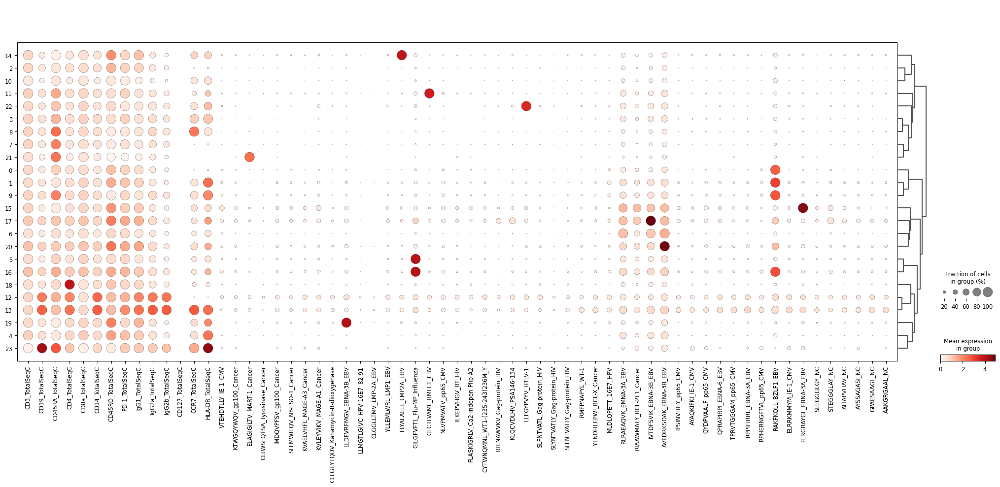

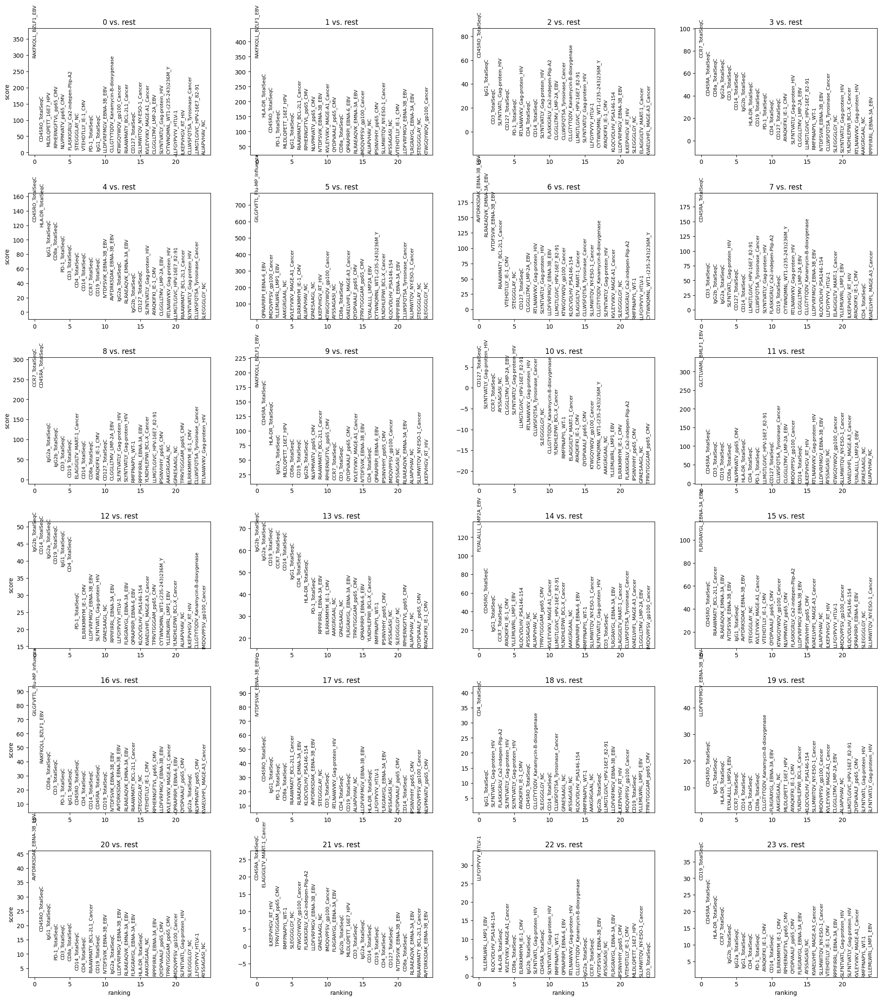

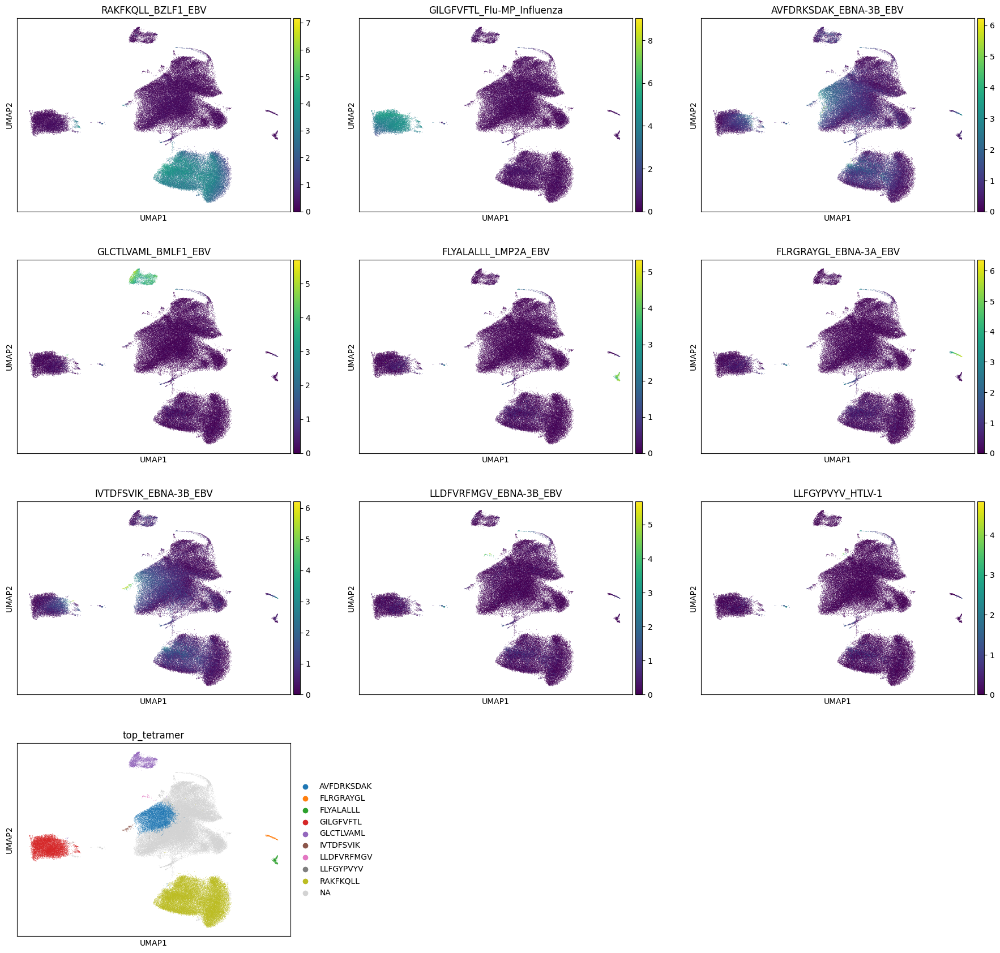

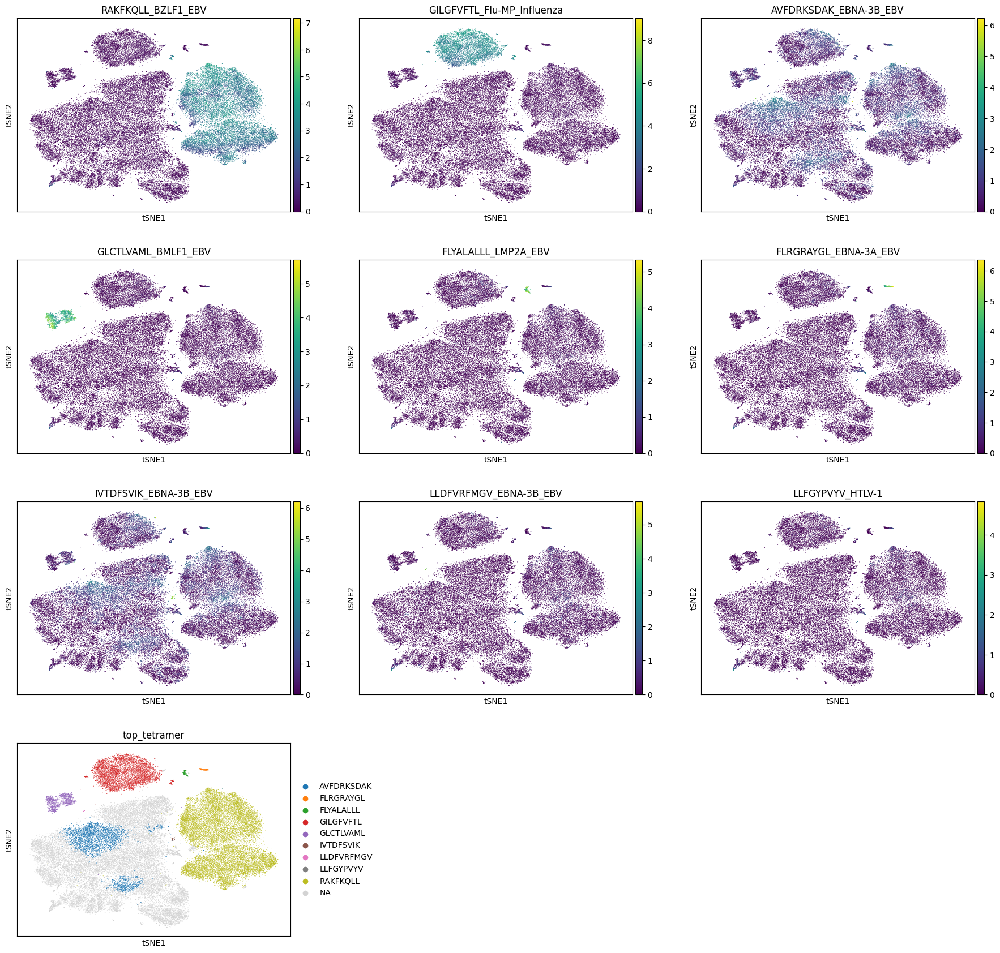

In [25]:
sc.pl.umap(
    prot,
    color=["leiden_res1"],
    legend_loc="on data",
    save=f'_clusters_{donor}.png')
sc.pl.dotplot(prot, prot.var.index, "leiden_res1", dendrogram=True,save=f'_clusters_{donor}.png')

sc.tl.rank_genes_groups(prot, "leiden_res1", method="t-test")
sc.pl.rank_genes_groups(prot, n_genes=25, sharey=False,save=f'_clusters_{donor}.png')

sc.pl.umap(prot, color=['RAKFKQLL_BZLF1_EBV','GILGFVFTL_Flu-MP_Influenza','AVFDRKSDAK_EBNA-3B_EBV','GLCTLVAML_BMLF1_EBV'
                        ,'FLYALALLL_LMP2A_EBV','FLRGRAYGL_EBNA-3A_EBV','IVTDFSVIK_EBNA-3B_EBV','LLDFVRFMGV_EBNA-3B_EBV','LLFGYPVYV_HTLV-1','top_tetramer'],ncols=3, save = f'_{donor}_top_tetramers_sc.png')
sc.pl.tsne(prot, color=['RAKFKQLL_BZLF1_EBV','GILGFVFTL_Flu-MP_Influenza','AVFDRKSDAK_EBNA-3B_EBV','GLCTLVAML_BMLF1_EBV'
                        ,'FLYALALLL_LMP2A_EBV','FLRGRAYGL_EBNA-3A_EBV','IVTDFSVIK_EBNA-3B_EBV','LLDFVRFMGV_EBNA-3B_EBV','LLFGYPVYV_HTLV-1','top_tetramer'],ncols=3, save = f'_{donor}_top_tetramers_sc.png')

In [26]:
prot.obs[~prot.obs['top_tetramer'].isna()].reset_index().rename({'index':'barcode'},axis=1)[['barcode','top_tetramer']].to_csv(f'{donor}_top_tetramer.csv',index=False)

## merged donors

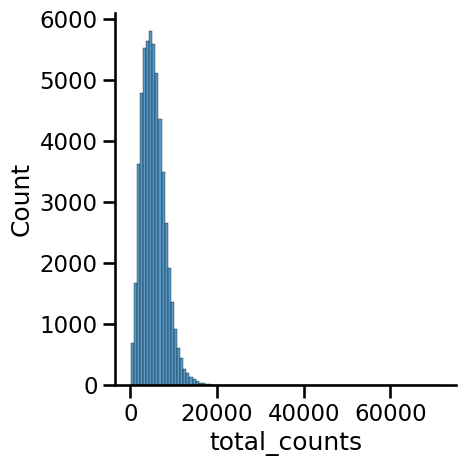

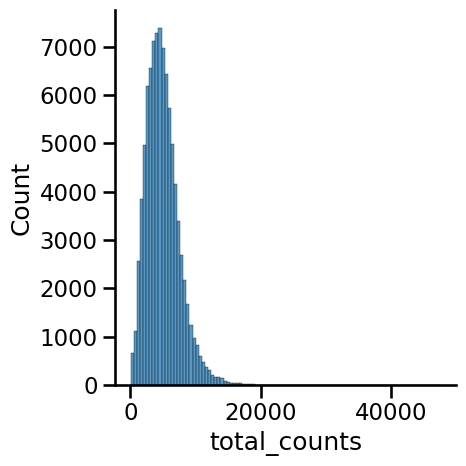

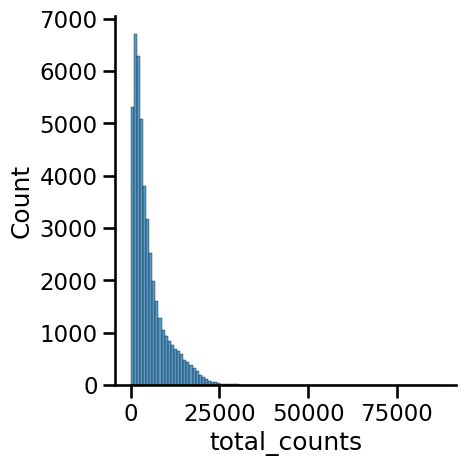

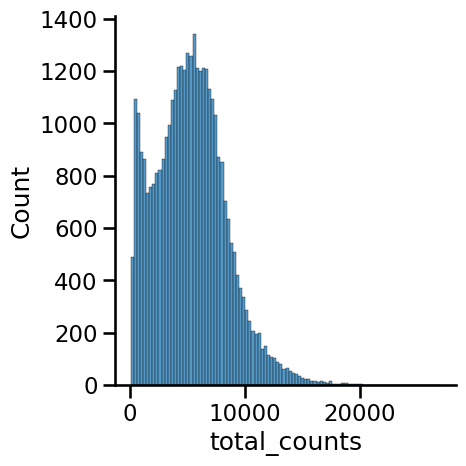

In [8]:
donor = 'donor1'
data_path = f'/home/ykremlyakova/projects/tcr_emb/data/10x/healthy/{donor}/vdj_v1_hs_aggregated_{donor}_filtered_feature_bc_matrix.h5'
mdata = mu.read_10x_h5(data_path)
mdata.shape
prot_1 = mdata['prot']
prot_1.obs['sample'] = donor
sc.pp.calculate_qc_metrics(prot_1, inplace=True, percent_top=None)
prot_1 = prot_1[prot_1.obs.n_genes_by_counts > 4]
prot_1 = prot_1[prot_1.obs.n_genes_by_counts < 58]
sns.displot(prot_1.obs["total_counts"], bins=100, kde=False)

donor = 'donor2'
data_path = f'/home/ykremlyakova/projects/tcr_emb/data/10x/healthy/{donor}/vdj_v1_hs_aggregated_{donor}_filtered_feature_bc_matrix.h5'
mdata = mu.read_10x_h5(data_path)
mdata.shape
prot_2 = mdata['prot']
prot_2.obs['sample'] = donor
sc.pp.calculate_qc_metrics(prot_2, inplace=True, percent_top=None)
prot_2 = prot_2[prot_2.obs.n_genes_by_counts > 4]
prot_2 = prot_2[prot_2.obs.n_genes_by_counts < 58]
sns.displot(prot_2.obs["total_counts"], bins=100, kde=False)

donor = 'donor3'
data_path = f'/home/ykremlyakova/projects/tcr_emb/data/10x/healthy/{donor}/vdj_v1_hs_aggregated_{donor}_filtered_feature_bc_matrix.h5'
mdata = mu.read_10x_h5(data_path)
mdata.shape
prot_3 = mdata['prot']
prot_3.obs['sample'] = donor
sc.pp.calculate_qc_metrics(prot_3, inplace=True, percent_top=None)
prot_3 = prot_3[prot_3.obs.n_genes_by_counts > 4]
prot_3 = prot_3[prot_3.obs.n_genes_by_counts < 58]
sns.displot(prot_3.obs["total_counts"], bins=100, kde=False)

donor = 'donor4'
data_path = f'/home/ykremlyakova/projects/tcr_emb/data/10x/healthy/{donor}/vdj_v1_hs_aggregated_{donor}_filtered_feature_bc_matrix.h5'
mdata = mu.read_10x_h5(data_path)
mdata.shape
prot_4 = mdata['prot']
prot_4.obs['sample'] = donor
sc.pp.calculate_qc_metrics(prot_4, inplace=True, percent_top=None)
prot_4 = prot_4[prot_4.obs.n_genes_by_counts > 4]
prot_4 = prot_4[prot_4.obs.n_genes_by_counts < 58]
sns.displot(prot_4.obs["total_counts"], bins=100, kde=False)

View of AnnData object with n_obs × n_vars = 46027 × 64
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

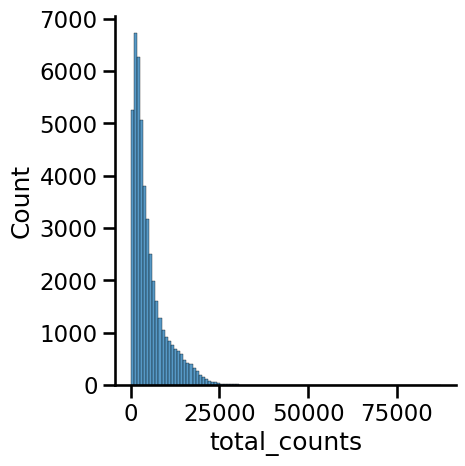

In [9]:
prot_3 = prot_3[prot_3.obs.total_counts > 10]
sns.displot(prot_3.obs["total_counts"], bins=100, kde=False)
prot_3

In [10]:
donor = 'multi'

In [11]:
prot = ad.concat([prot_1,prot_2,prot_3,prot_4], merge="unique")

In [12]:
prot

AnnData object with n_obs × n_vars = 229501 × 64
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts'
    var: 'gene_ids', 'feature_types', 'genome'

In [13]:
ac_set = set(prot.var.iloc[14:57].index)
ac_set = ac_set - set(prot.var[prot.var_names.str.startswith('KLG')].index)


In [14]:
prot_raw = prot.copy()
#prot = prot[:,prot.var_names.isin(ac_set)]
klg = prot.var_names.str.startswith('KLG')
prot = prot[:,np.invert(klg)]

In [15]:
mu.prot.pp.clr(prot)

In [16]:
adata_bbknn = prot.copy()

In [17]:
sc.pp.pca(adata_bbknn)


In [18]:
bbknn.bbknn(
    adata_bbknn, batch_key='sample', neighbors_within_batch=5
)

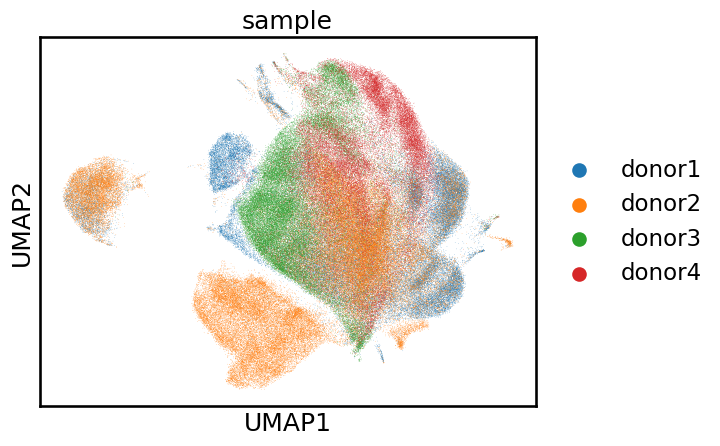

In [19]:
sc.tl.umap(adata_bbknn)
sc.pl.umap(adata_bbknn, color=['sample'], wspace=1, save=f'_{donor}_donors.png')

In [20]:
sc.tl.tsne(adata_bbknn, use_rep="X_pca")

In [21]:
sc.tl.leiden(adata_bbknn, key_added="leiden_res1", resolution=1.0)

IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out


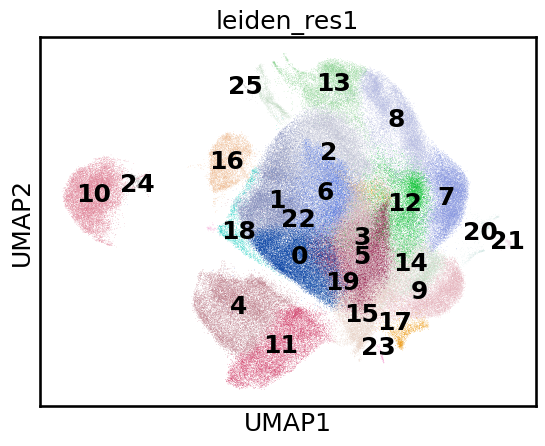

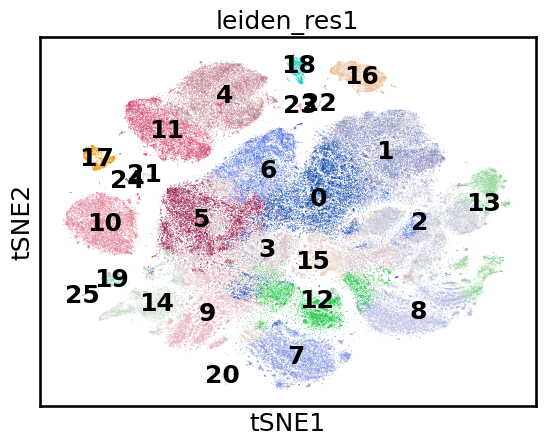

In [22]:
sc.pl.umap(adata_bbknn, color=['leiden_res1'], legend_loc="on data")
sc.pl.tsne(adata_bbknn, color=['leiden_res1'], legend_loc="on data")

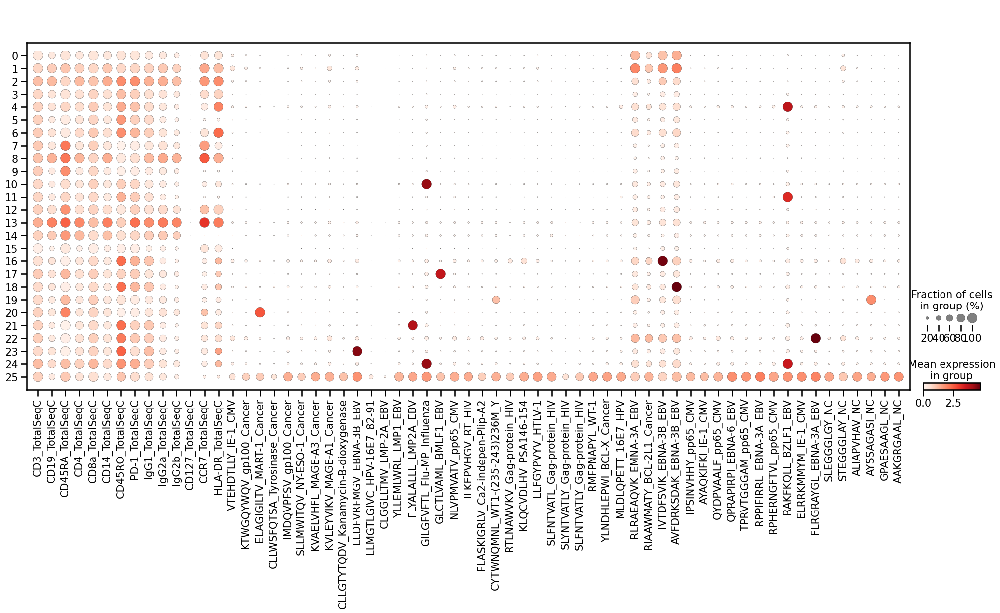

In [23]:
sc.pl.dotplot(adata_bbknn, adata_bbknn.var.index, "leiden_res1")

In [ ]:
sc.tl.leiden(adata_bbknn, key_added="leiden_res2", resolution=2.0)

In [258]:
sc.tl.leiden(adata_bbknn, key_added="leiden_res3", resolution=3.0)

In [259]:
sc.tl.leiden(adata_bbknn, key_added="leiden_res4", resolution=4.0)

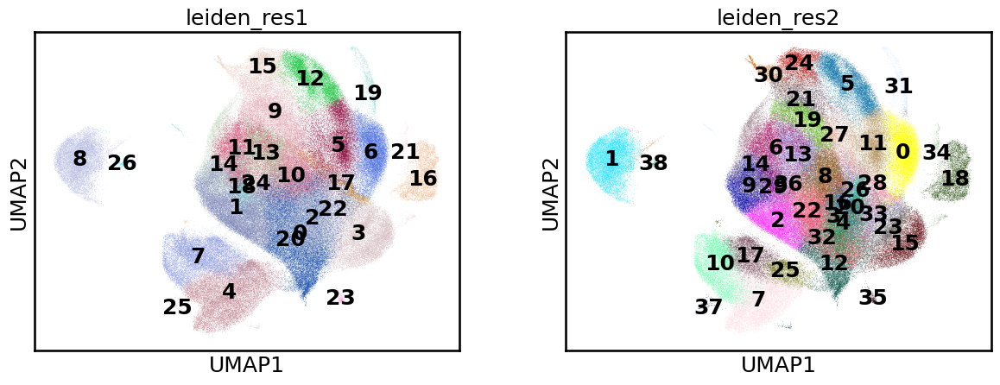

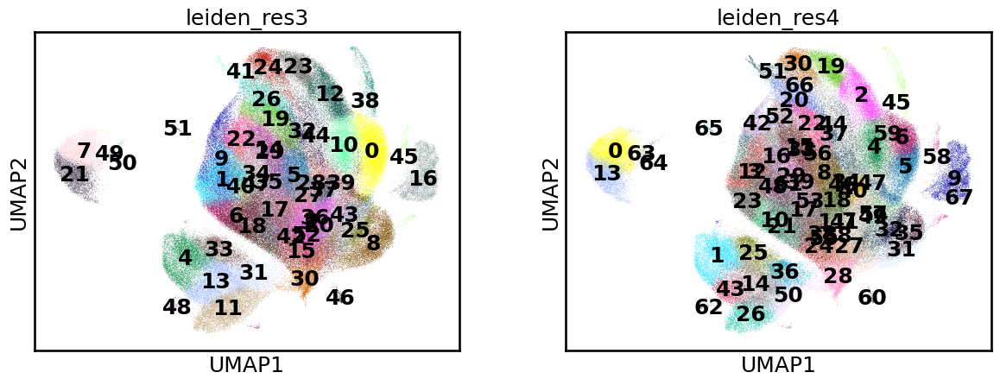

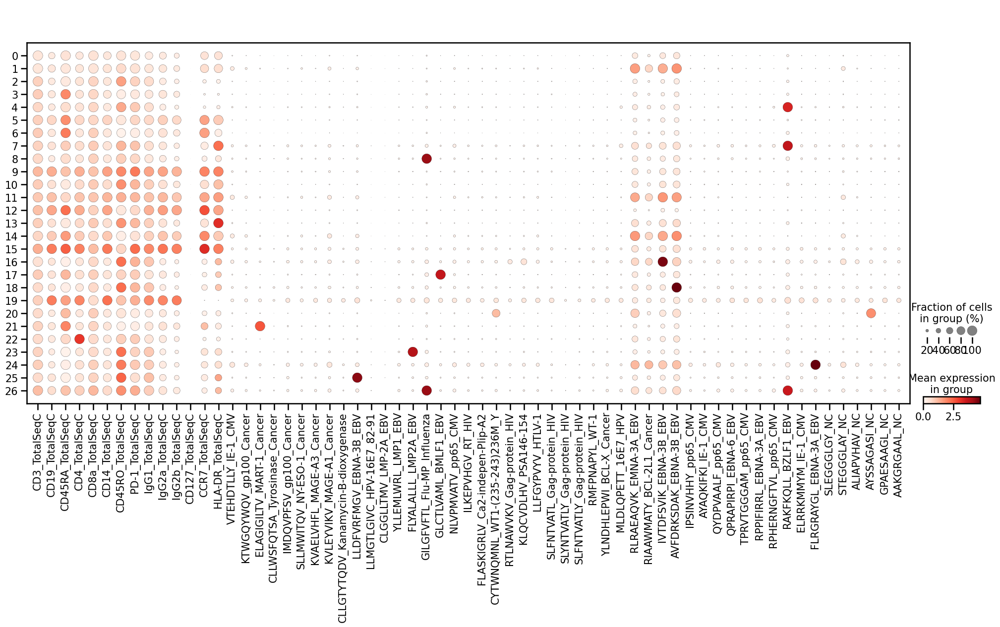

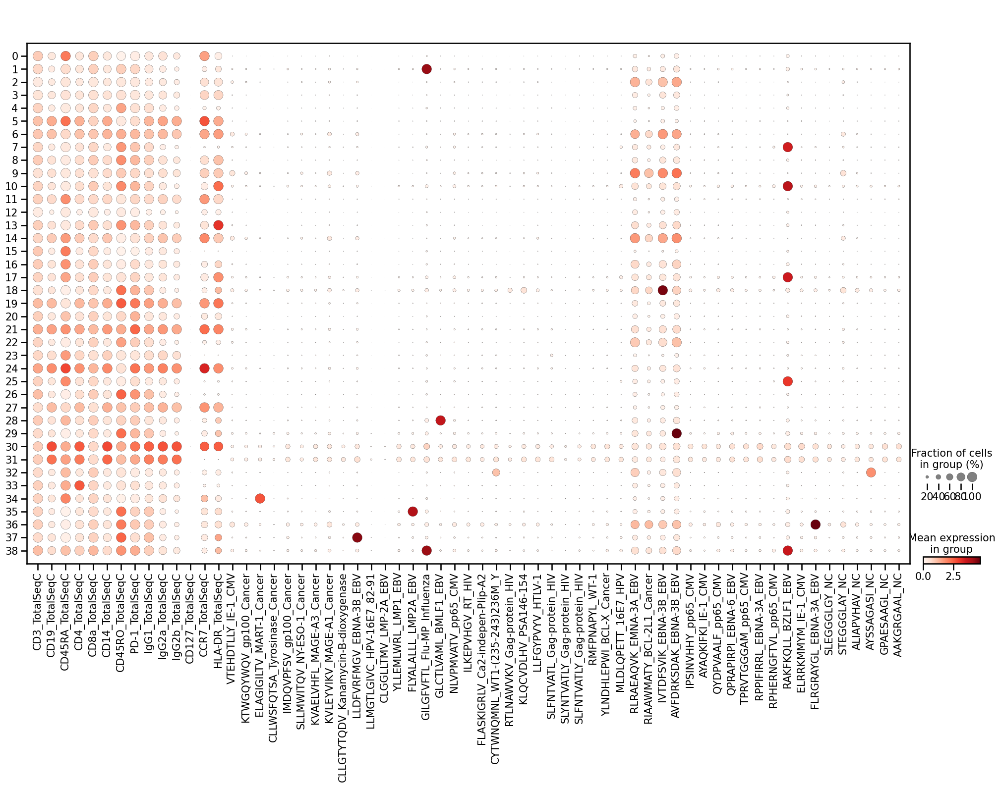

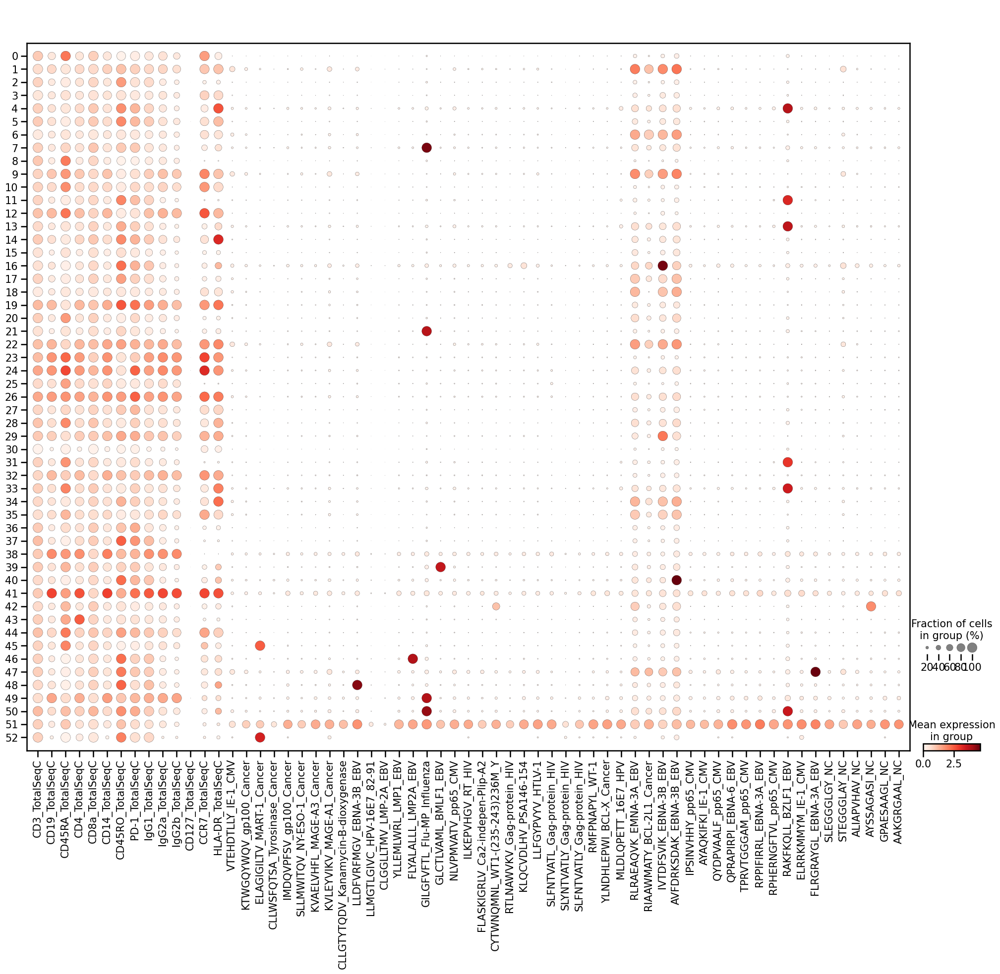

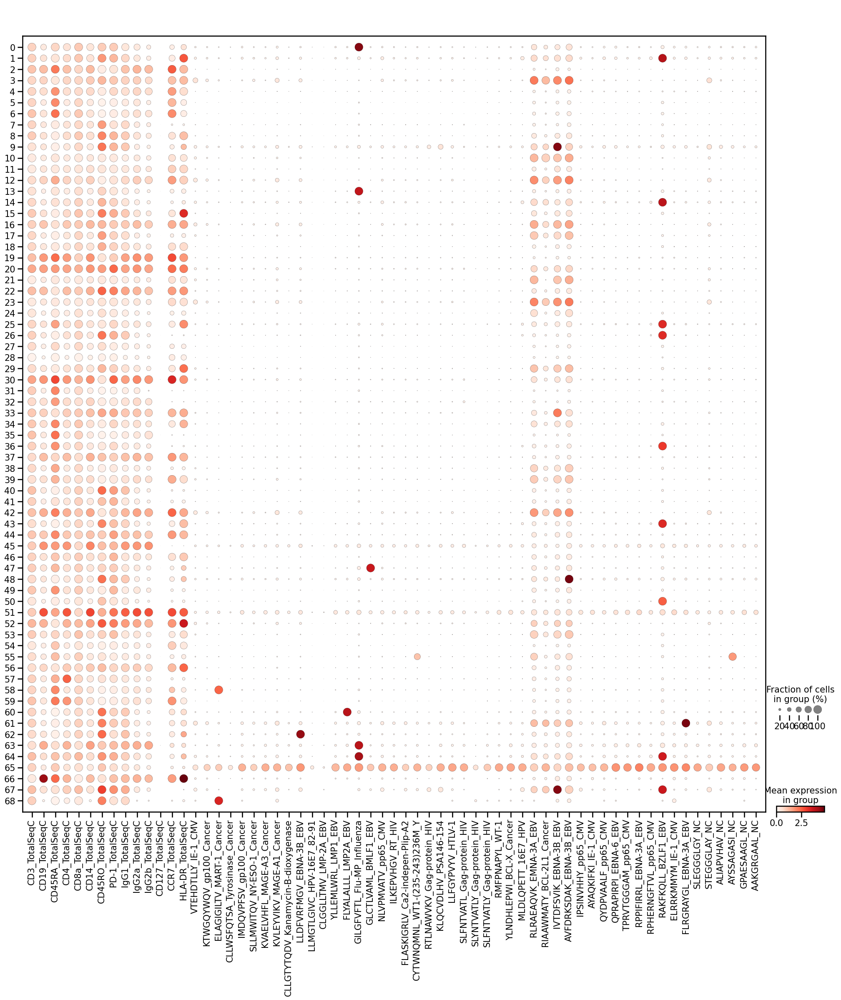

In [261]:
#sc.pl.tsne(
#    adata_bbknn,
#    color=["leiden_res1", "leiden_res2"],
#    legend_loc="on data",
#    save=f'_{donor}_l1_l2.png'
#)
sc.pl.umap(
    adata_bbknn,
    color=[ "leiden_res1", "leiden_res2"],
    legend_loc="on data",
    save=f'_{donor}_l1_l2.png'
)

#sc.pl.tsne(
#    adata_bbknn,
#    color=["leiden_res3", "leiden_res4"],
#    legend_loc="on data",save=f'_{donor}_l3_l4.png'
#)

sc.pl.umap(
    adata_bbknn,
    color=["leiden_res3", "leiden_res4"],
    legend_loc="on data",save=f'_{donor}_l3_l4.png'
)


sc.pl.dotplot(adata_bbknn, adata_bbknn.var.index, "leiden_res1", save=f'_{donor}_l1.png')
sc.pl.dotplot(adata_bbknn, adata_bbknn.var.index, "leiden_res2", save=f'_{donor}_l2.png')
sc.pl.dotplot(adata_bbknn, adata_bbknn.var.index, "leiden_res3", save=f'_{donor}_l3.png')
sc.pl.dotplot(adata_bbknn, adata_bbknn.var.index, "leiden_res4", save=f'_{donor}_l4.png')

In [ ]:
sc.tl.rank_genes_groups(adata_bbknn, "leiden_res1", method="t-test")
sc.pl.rank_genes_groups(adata_bbknn, n_genes=25, sharey=False, save = f'_{donor}_l1.png')

In [ ]:
adata_bbknn.obs

### get table of clusters and donors

In [266]:
pd.set_option('display.max_rows', 200)

In [274]:
l = 'leiden_res4'
sc.tl.rank_genes_groups(adata_bbknn, l, method="t-test")
result = adata_bbknn.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.set_option('display.max_columns', 50)
t = pd.DataFrame(
    {group: result['names'][group]
    for group in groups}).head(1).T.rename({0:'top_tetramer'},axis=1)
t = t.reset_index().rename({'index':l},axis=1)

t2 = pd.DataFrame(
    {group: result['pvals'][group]
    for group in groups}).head(1).T.rename({0:'pvals'},axis=1)
t2 = t2.reset_index().rename({'index':l},axis=1)
r = adata_bbknn.obs.rename({'n_genes_by_counts':'cluster_size_in_donor'},axis=1).groupby([l,'sample']).count()['cluster_size_in_donor'].reset_index()
r = adata_bbknn.obs.rename({'n_genes_by_counts':'cluster_size'},axis=1).groupby([l]).count()['cluster_size'].reset_index().merge(r)
r = r.merge(t).merge(t2)
r = r[r['pvals']<0.05]

In [275]:
r[r['top_tetramer'].isin(ac_set)]

,leiden_res4,cluster_size,sample,cluster_size_in_donor,top_tetramer,pvals
0,0,7499,donor1,1342,GILGFVFTL_Flu-MP_Influenza,0.000000e+00
1,0,7499,donor2,6141,GILGFVFTL_Flu-MP_Influenza,0.000000e+00
2,0,7499,donor3,13,GILGFVFTL_Flu-MP_Influenza,0.000000e+00
3,0,7499,donor4,3,GILGFVFTL_Flu-MP_Influenza,0.000000e+00
4,1,7465,donor1,87,RAKFKQLL_BZLF1_EBV,0.000000e+00
5,1,7465,donor2,7376,RAKFKQLL_BZLF1_EBV,0.000000e+00
6,1,7465,donor3,0,RAKFKQLL_BZLF1_EBV,0.000000e+00
7,1,7465,donor4,2,RAKFKQLL_BZLF1_EBV,0.000000e+00
12,3,6463,donor1,267,AVFDRKSDAK_EBNA-3B_EBV,0.000000e+00
13,3,6463,donor2,346,AVFDRKSDAK_EBNA-3B_EBV,0.000000e+00


### save top_tetramer and barcodes

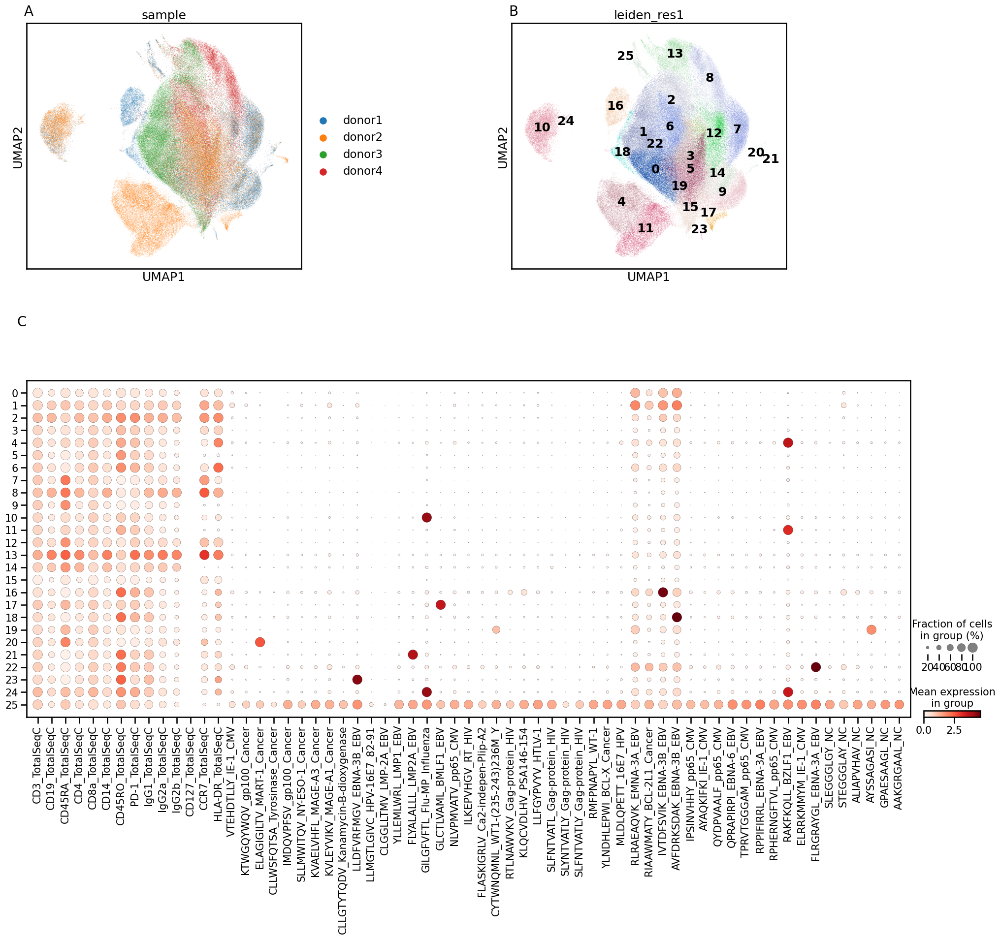

In [25]:

fig = plt.figure(figsize=(25,20))
delta_x=-0.01
delta_y=1.1
font_size=20

gs00 = fig.add_gridspec(12, 10)

ax1 = fig.add_subplot(gs00[:4, :3])
ax2 = fig.add_subplot(gs00[:4, 5:8])
ax3 = fig.add_subplot(gs00[5:11, :])

sc.pl.umap(adata_bbknn, color=['sample'], wspace=1, ax = ax1,show=False)
ax1.text(delta_x, delta_y - 0.025, 'A',
     horizontalalignment='left',
     verticalalignment='top',
    transform=ax1.transAxes,
        size=font_size)
sc.pl.umap(adata_bbknn, color=['leiden_res1'], legend_loc="on data",ax = ax2,show=False)
ax2.text(delta_x, delta_y - 0.025, 'B',
     horizontalalignment='left',
     verticalalignment='top',
    transform=ax2.transAxes,
        size=font_size)
sc.pl.dotplot(adata_bbknn, adata_bbknn.var.index, "leiden_res1",ax=ax3,show=False)
ax3.text(delta_x, delta_y - 0.025, 'C',
     horizontalalignment='left',
     verticalalignment='top',
    transform=ax3.transAxes,
        size=font_size)
plt.savefig(str("sc_clusters_donors.png"),bbox_inches='tight')

In [276]:
l = 'leiden_res1'
sc.tl.rank_genes_groups(adata_bbknn, l, method="t-test")
result = adata_bbknn.uns['rank_genes_groups']
groups = result['names'].dtype.names
pd.set_option('display.max_columns', 50)
t = pd.DataFrame(
    {group: result['names'][group]
    for group in groups}).head(1).T.rename({0:'top_tetramer'},axis=1)
t = t.reset_index().rename({'index':l},axis=1)

t2 = pd.DataFrame(
    {group: result['pvals'][group]
    for group in groups}).head(1).T.rename({0:'pvals'},axis=1)
t2 = t2.reset_index().rename({'index':l},axis=1)
r = t.merge(t2)
r = r[r['pvals']<0.05]
r = r[r['top_tetramer'].isin(ac_set)]
r

,leiden_res1,top_tetramer,pvals
1,1,AVFDRKSDAK_EBNA-3B_EBV,0.000000e+00
4,4,RAKFKQLL_BZLF1_EBV,0.000000e+00
7,7,RAKFKQLL_BZLF1_EBV,0.000000e+00
8,8,GILGFVFTL_Flu-MP_Influenza,0.000000e+00
11,11,IVTDFSVIK_EBNA-3B_EBV,0.000000e+00
14,14,AVFDRKSDAK_EBNA-3B_EBV,0.000000e+00
16,16,IVTDFSVIK_EBNA-3B_EBV,0.000000e+00
17,17,GLCTLVAML_BMLF1_EBV,0.000000e+00
18,18,AVFDRKSDAK_EBNA-3B_EBV,0.000000e+00
21,21,ELAGIGILTV_MART-1_Cancer,0.000000e+00


In [277]:
cl_annotation = dict(zip(r['leiden_res1'], r['top_tetramer']))
cl_annotation

{'1': 'AVFDRKSDAK_EBNA-3B_EBV',
 '4': 'RAKFKQLL_BZLF1_EBV',
 '7': 'RAKFKQLL_BZLF1_EBV',
 '8': 'GILGFVFTL_Flu-MP_Influenza',
 '11': 'IVTDFSVIK_EBNA-3B_EBV',
 '14': 'AVFDRKSDAK_EBNA-3B_EBV',
 '16': 'IVTDFSVIK_EBNA-3B_EBV',
 '17': 'GLCTLVAML_BMLF1_EBV',
 '18': 'AVFDRKSDAK_EBNA-3B_EBV',
 '21': 'ELAGIGILTV_MART-1_Cancer',
 '23': 'FLYALALLL_LMP2A_EBV',
 '25': 'LLDFVRFMGV_EBNA-3B_EBV',
 '26': 'GILGFVFTL_Flu-MP_Influenza'}

In [278]:

adata_bbknn.obs["top_tetramer"] = adata_bbknn.obs.leiden_res1.map(cl_annotation)


In [287]:
donor = 'donor1'
d =  adata_bbknn[adata_bbknn.obs['sample']==donor].copy()
d.obs[~d.obs['top_tetramer'].isna()].reset_index().rename({'index':'barcode'},axis=1)[['barcode','top_tetramer']].to_csv(f'{donor}_top_tetramer.csv',index=False)
donor = 'donor2'
d =  adata_bbknn[adata_bbknn.obs['sample']==donor].copy()
d.obs[~d.obs['top_tetramer'].isna()].reset_index().rename({'index':'barcode'},axis=1)[['barcode','top_tetramer']].to_csv(f'{donor}_top_tetramer.csv',index=False)
donor = 'donor3'
d =  adata_bbknn[adata_bbknn.obs['sample']==donor].copy()
d.obs[~d.obs['top_tetramer'].isna()].reset_index().rename({'index':'barcode'},axis=1)[['barcode','top_tetramer']].to_csv(f'{donor}_top_tetramer.csv',index=False)
donor = 'donor4'
d =  adata_bbknn[adata_bbknn.obs['sample']==donor].copy()
d.obs[~d.obs['top_tetramer'].isna()].reset_index().rename({'index':'barcode'},axis=1)[['barcode','top_tetramer']].to_csv(f'{donor}_top_tetramer.csv',index=False)

### without batch correction 

In [ ]:
sc.tl.leiden(prot, key_added="leiden_res0_75", resolution=0.75)
sc.tl.leiden(prot, key_added="leiden_res1", resolution=1.0)

In [ ]:
sc.tl.leiden(prot, key_added="leiden_res2", resolution=2.0)
sc.tl.leiden(prot, key_added="leiden_res3", resolution=3.0)


In [ ]:
sc.tl.leiden(prot, key_added="leiden_res4", resolution=4.0)

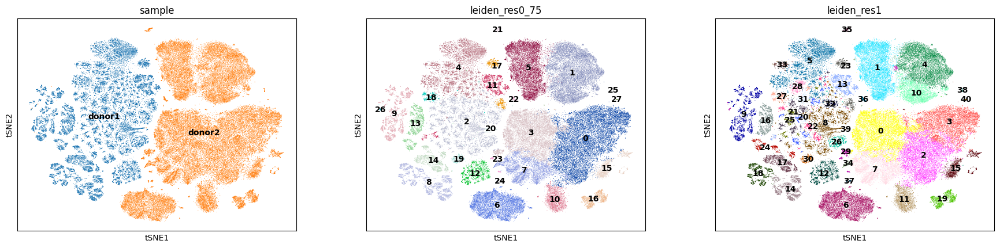

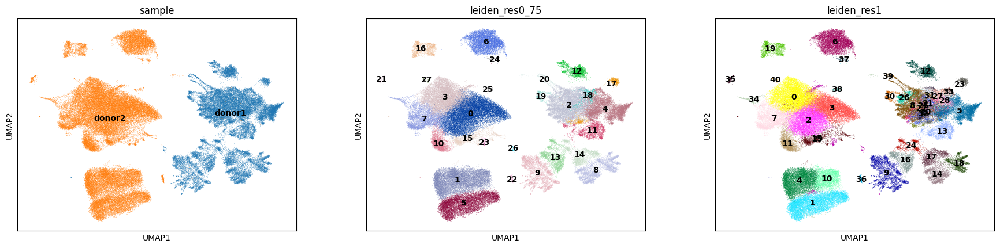

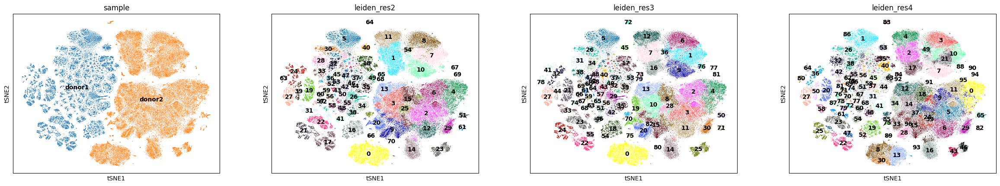

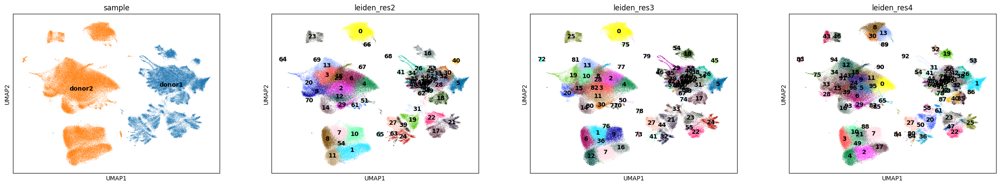

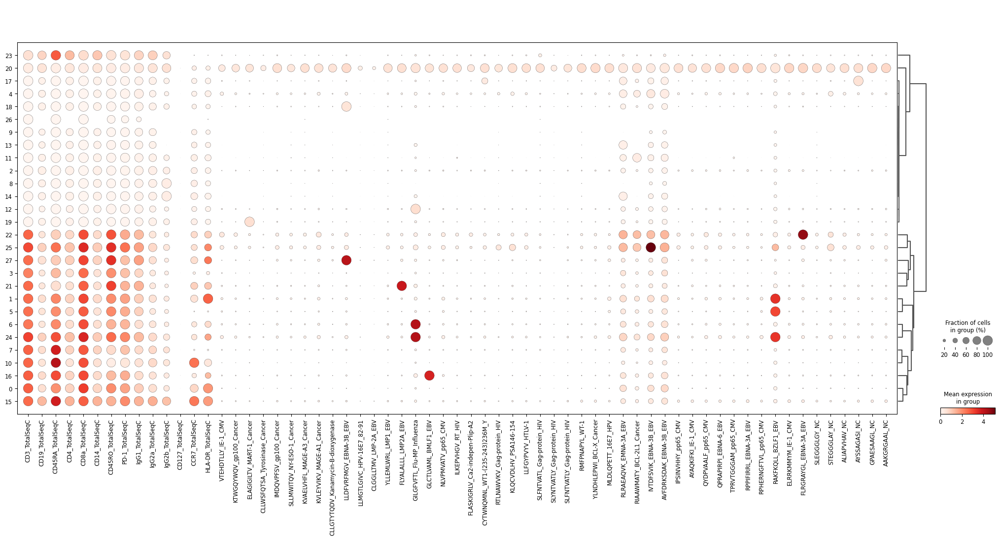

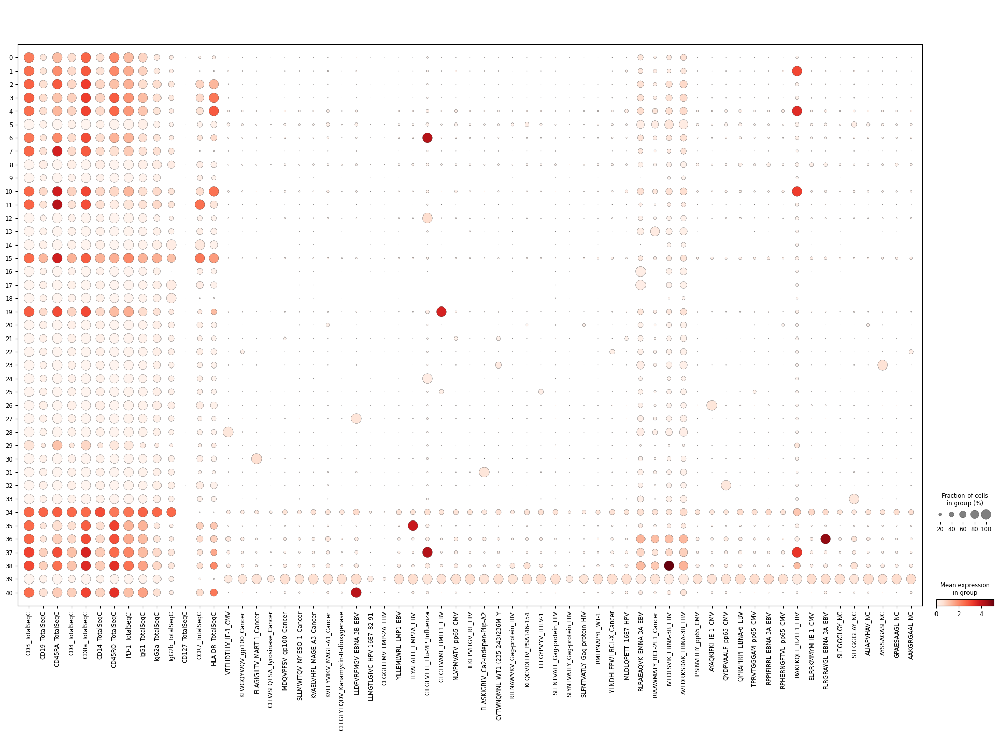

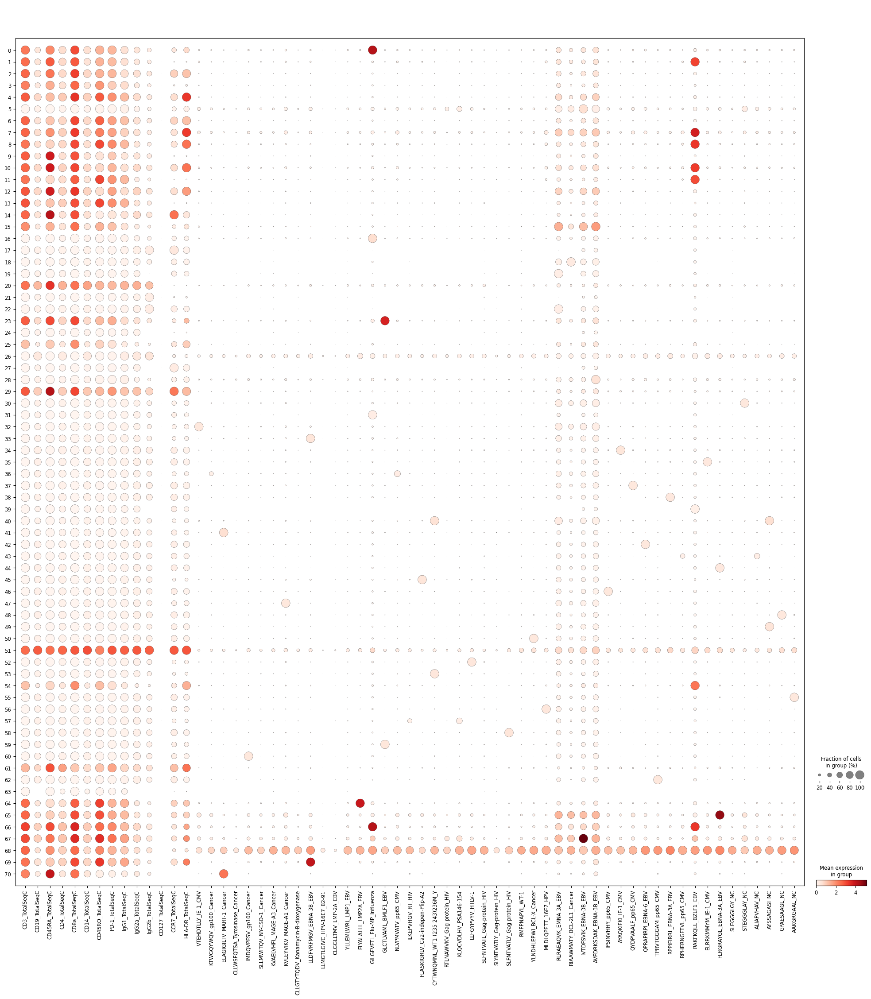

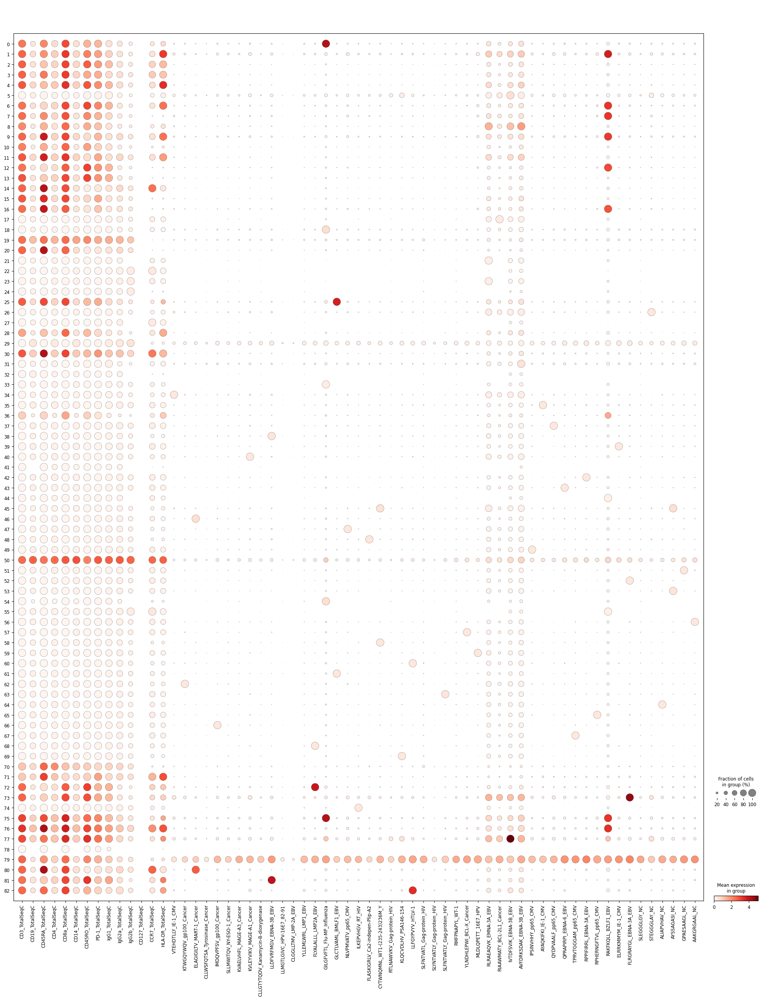

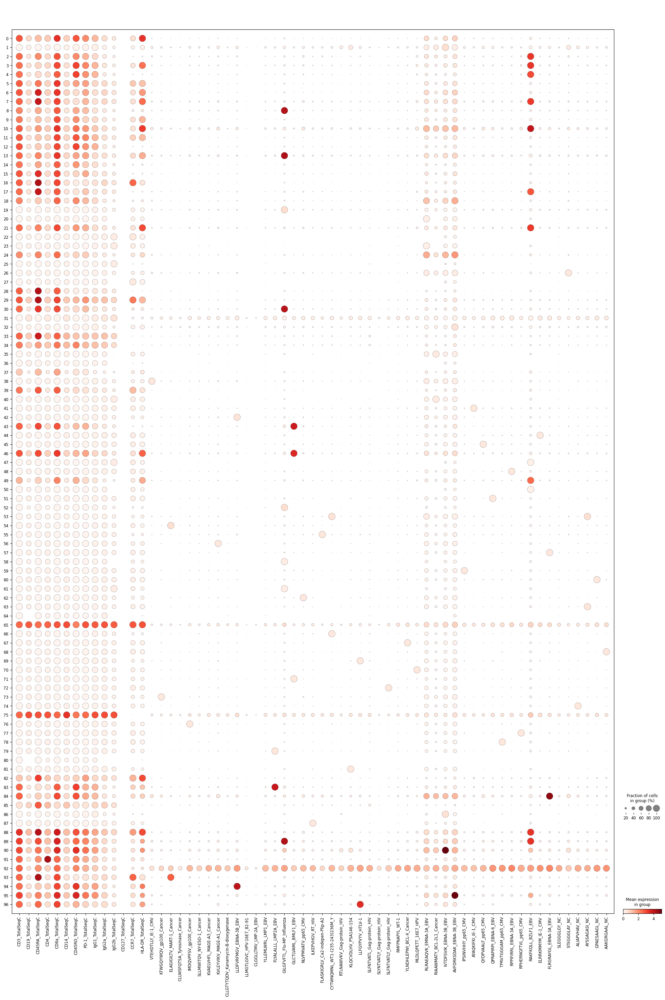

In [179]:
sc.pl.tsne(
    prot,
    color=["sample","leiden_res0_75", "leiden_res1"],
    legend_loc="on data",
)
sc.pl.umap(
    prot,
    color=[ "sample","leiden_res0_75", "leiden_res1"],
    legend_loc="on data",
)

sc.pl.tsne(
    prot,
    color=["leiden_res2","leiden_res3", "leiden_res4"],
    legend_loc="on data",
)

sc.pl.umap(
    prot,
    color=[ "leiden_res2","leiden_res3", "leiden_res4"],
    legend_loc="on data",
)


sc.pl.dotplot(prot, prot.var.index, "leiden_res0_75", dendrogram=True)
sc.pl.dotplot(prot, prot.var.index, "leiden_res1", save=f'_{donor}_l1.png')
sc.pl.dotplot(prot, prot.var.index, "leiden_res2", save=f'_{donor}_l2.png')
sc.pl.dotplot(prot, prot.var.index, "leiden_res3", save=f'_{donor}_l3.png')
sc.pl.dotplot(prot, prot.var.index, "leiden_res4", save=f'_{donor}_l4.png')

mu.prot.pp.clr(prot)
sc.tl.pca(prot)
sc.pp.neighbors(prot)
sc.tl.umap(prot, random_state=1)
sc.tl.leiden(prot, key_added="leiden_res0_75", resolution=0.75)
sc.tl.leiden(prot, key_added="leiden_res1", resolution=1.0)
sc.tl.leiden(prot, key_added="leiden_res2", resolution=2.0)
sc.tl.leiden(prot, key_added="leiden_res3", resolution=3.0)
sc.tl.leiden(prot, key_added="leiden_res4", resolution=4.0)
sc.tl.tsne(prot, use_rep="X_pca")
sc.pl.tsne(
    prot,
    color=[ "leiden_res0_5","leiden_res0_75", "leiden_res1"],
    legend_loc="on data",
)
sc.pl.umap(
    prot,
    color=[ "leiden_res0_5","leiden_res0_75", "leiden_res1"],
    legend_loc="on data",
)

sc.pl.tsne(
    prot,
    color=[ "leiden_res2","leiden_res3", "leiden_res4"],
    legend_loc="on data",
)

sc.pl.umap(
    prot,
    color=[ "leiden_res2","leiden_res3", "leiden_res4"],
    legend_loc="on data",
)

sc.pl.dotplot(prot, prot.var.index, "leiden_res0_5", dendrogram=True)
sc.pl.dotplot(prot, prot.var.index, "leiden_res0_75", dendrogram=True)
sc.pl.dotplot(prot, prot.var.index, "leiden_res1", save=f'_{donor}_l1.png')
sc.pl.dotplot(prot, prot.var.index, "leiden_res2", save=f'_{donor}_l2.png')
sc.pl.dotplot(prot, prot.var.index, "leiden_res3", save=f'_{donor}_l3.png')
sc.pl.dotplot(prot, prot.var.index, "leiden_res4", save=f'_{donor}_l4.png')